# Primacy/Significance of WV-WVs to input cells
Do the cells that send synapses to the WV-WVs mainly send projections to WV-WVs? How significant are WV-WVs to their input cells?

Method: perform a significance analysis using the same process/methods from oviIN repository

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn
import networkx as nx
plt.rcParams["pdf.fonttype"] = 42
plt.rcParams["font.sans-serif"] = "Helvetica"
import bokeh.palettes
mpl.rcParams['figure.dpi'] = 300

# Organizing data

In [3]:
#import connections/synapses data from FlyWire
connections = pd.read_csv('connections_princeton.csv.gz', compression='gzip').drop(columns='neuropil')

#since certain root ids express different neurotransmitters, the same connection shows up multiple times due to different nt types
#group by neurotransmitters, df only keeps connections with primary nt (nt connection highest syn count for each pre root id)
ntsgrouped = connections.groupby(['pre_root_id', 'post_root_id', 'nt_type'], as_index=False)[['syn_count']].sum()

#keep only the strongest connection for duplicate connections with different nt types
conns = ntsgrouped.sort_values(by='syn_count', ascending=False).drop_duplicates(subset=['pre_root_id', 'post_root_id'], keep='first')
conns

,pre_root_id,post_root_id,nt_type,syn_count
3687238,720575940650935673,720575940640736371,GABA,2633
2320879,720575940628069501,720575940633305681,GABA,2597
3596036,720575940644702112,720575940625952755,GABA,2238
1631524,720575940623475324,720575940627497244,GABA,2179
1246516,720575940620975696,720575940624547622,DA,1872
...,...,...,...,...
3073466,720575940633914413,720575940615905130,GLUT,5
1582223,720575940623166600,720575940622950424,ACH,5
3073469,720575940633914413,720575940622525168,GLUT,5
1582220,720575940623166600,720575940618583877,ACH,5


In [4]:
#import cell types dataframe from FlyWire
celltypes = pd.read_csv('consolidated_cell_types.csv.gz', compression='gzip')
celltypes = celltypes.rename(columns={'primary_type':'type'})

#import list of wvwvs from prof. gutierrez
wvwv_bakerlab = pd.read_csv('WV-WV 20250506 - Sheet1.csv')

#make obj names for each wvwv root id for easier querying further down the line
wvwv_rootids = wvwv_bakerlab['Codex Root ID'].tolist()
wvwv1_rootids = (wvwv_bakerlab[wvwv_bakerlab['Cell type'] == 'WV-WV-1'])['Codex Root ID'].tolist()
wvwv2_rootids = (wvwv_bakerlab[wvwv_bakerlab['Cell type'] == 'WV-WV-2'])['Codex Root ID'].tolist()
wvwv3_rootids = (wvwv_bakerlab[wvwv_bakerlab['Cell type'] == 'WV-WV-3'])['Codex Root ID'].tolist()
wvwv4_rootids = (wvwv_bakerlab[wvwv_bakerlab['Cell type'] == 'WV-WV-4'])['Codex Root ID'].tolist()

#changing type names of wv-wv-3s to wv-wv-4s (per Baker et al.)

celltypes.loc[celltypes['root_id'].isin(wvwv4_rootids), 'type']='WV-WV-4'

celltypes


,root_id,type,additional_type(s)
0,720575940596125868,T5c,NaN
1,720575940597856265,Tm16,NaN
2,720575940597944841,Tm7,CB3851
3,720575940598267657,TmY15,NaN
4,720575940599333574,Tm1,NaN
...,...,...,...
137672,720575940661335681,CB0180,NaN
137673,720575940661336193,TmY3,NaN
137674,720575940661337217,KCab-p,NaN
137675,720575940661338497,CB0904,NaN


In [6]:
#import auditory neuron mode preference df from ahmed lab
aud_neurons = pd.read_csv('train_dat.csv')
aud_neurons

#change column names so easier to do operations

aud_neurons = aud_neurons.rename(columns={
    'Flywire 2024 ID':'root_id',
    'Neuropils':'type' 
    }).drop([
        'Unnamed: 0',
        '# imaged females', 
        '# responding females',
        'prop females with auditory responses'], axis=1
        )

#merge celltypes and aud_neurons into one prioritized labels/types df, which will be used first when merging with conns df
#if there is no correpsonding cell type from Baker/Ahmed lab data, then fill in with cell types data from FlyWire

types = pd.merge(
    celltypes,
    aud_neurons,
    on = 'root_id',
    how = 'left',
    suffixes = ('_celltypes', '_aud')
)

types['type'] = types['type_aud'].combine_first(types['type_celltypes'])
types = types[['root_id', 'type', 'preference']]
types

,root_id,type,preference
0,720575940596125868,T5c,NaN
1,720575940597856265,Tm16,NaN
2,720575940597944841,Tm7,NaN
3,720575940598267657,TmY15,NaN
4,720575940599333574,Tm1,NaN
...,...,...,...
137672,720575940661335681,CB0180,NaN
137673,720575940661336193,TmY3,NaN
137674,720575940661337217,KCab-p,NaN
137675,720575940661338497,CB0904,NaN


In [7]:
#Christa Baker just shared the list of auditory neurons with me so I'm going to use this table from ahmed lab twist for classifications (all neurons in this dataframe will be considered auditory)

auditory_cells = pd.read_csv('Auditory neurons Lockwood et al - Sheet1.csv')

#create list of auditory ids for table filtering
aud_ids = auditory_cells['Codex June 2024'].tolist()

#since the baker spreadsheet has better labelling of cell types, see if any cells listed as 'auditory' have generic names, and change if possible

aud_types = types[types['root_id'].isin(aud_ids)][['root_id', 'type']].drop_duplicates()

#since all generic names start with CB filter for those
#renaming generic cell type names with non-generic ones (if possible) will make analysis easier

aud_generic_typenames = aud_types[aud_types['type'].str.contains('CB')]

aud_generic_rootids = aud_generic_typenames['root_id'].tolist()
aud_generic_rootids

[720575940603903264,
 720575940603930046,
 720575940606919602,
 720575940614190242,
 720575940615308729,
 720575940615503249,
 720575940615894877,
 720575940616748756,
 720575940618149336,
 720575940618772719,
 720575940620833974,
 720575940621159181,
 720575940623020263,
 720575940623855397,
 720575940624463242,
 720575940624571116,
 720575940625146122,
 720575940625466387,
 720575940625597317,
 720575940626990086,
 720575940627027087,
 720575940628244064,
 720575940629133071,
 720575940629394232,
 720575940629552170,
 720575940630214564,
 720575940634545294,
 720575940636705502,
 720575940644300323,
 720575940644488727,
 720575940650920569]

In [8]:
#now see if any of these have type name labelling from lockwood et al spreadsheet

new_labels = auditory_cells[auditory_cells['Codex June 2024'].isin(aud_generic_rootids)][['Cell type (Baker et al 2022)', 'Codex June 2024']].dropna() #these are names that can added to types_conns and types
codex_generic_type = types[types['root_id'].isin(new_labels['Codex June 2024'])]

#replace names by first matching root ids from both dfs

matching_types = pd.merge(
    codex_generic_type,
    new_labels,
    how = 'left',
    left_on = 'root_id',
    right_on = 'Codex June 2024'
)
matching_types

,root_id,type,preference,Cell type (Baker et al 2022),Codex June 2024
0,720575940615894877,CB1385,NaN,vpoIN,720575940615894877
1,720575940623855397,CB1161,NaN,pC2la,720575940623855397
2,720575940624463242,CB0666,NaN,pMN1,720575940624463242
3,720575940634545294,CB2375,NaN,pC2la,720575940634545294
4,720575940636705502,CB1385,NaN,vpoIN,720575940636705502
5,720575940644300323,CB0666,NaN,pMN1,720575940644300323


In [9]:
#merge first onto presynaptic (all type and preference information refers to presynaptic cell)

conns_firstmerge = conns.merge(
    types,
    how = 'left',
    left_on = 'pre_root_id',
    right_on = 'root_id'
).drop(columns='root_id').rename(columns={'type':'type_pre', 'preference':'pref_pre'})

#merge again this time for postsynaptic (type and preference information refers to postsynaptic cell)

conns_types = conns_firstmerge.merge(
    types,
    how = 'left',
    left_on = 'post_root_id',
    right_on = 'root_id'
).drop(columns='root_id').rename(columns={'type':'type_post', 'preference':'pref_post'})

conns_types = conns_types[['pre_root_id', 'post_root_id', 'syn_count', 'nt_type', 'type_pre', 'type_post', 'pref_pre', 'pref_post']]
conns_types

,pre_root_id,post_root_id,syn_count,nt_type,type_pre,type_post,pref_pre,pref_post
0,720575940650935673,720575940640736371,2633,GABA,Li32,Li30,NaN,NaN
1,720575940628069501,720575940633305681,2597,GABA,Li32,Li30,NaN,NaN
2,720575940644702112,720575940625952755,2238,GABA,LT39,Li33,NaN,NaN
3,720575940623475324,720575940627497244,2179,GABA,LT39,Li33,NaN,NaN
4,720575940620975696,720575940624547622,1872,DA,DPM,APL,NaN,NaN
...,...,...,...,...,...,...,...,...
3732455,720575940633914413,720575940615905130,5,GLUT,TmY14,Pm11,NaN,NaN
3732456,720575940623166600,720575940622950424,5,ACH,L5,Tm21,NaN,NaN
3732457,720575940633914413,720575940622525168,5,GLUT,TmY14,Li26,NaN,NaN
3732458,720575940623166600,720575940618583877,5,ACH,L5,TmY3,NaN,NaN


In [10]:
#add 'class' column distinguishing each neuron as auditory or non auditory based on csv provided by Baker
#create new column specifically stating whether non-wvwv cell is auditory or not

conns_types['class_pre'] = np.where(conns_types['pre_root_id'].isin(aud_ids), 'auditory', 'non-auditory')
conns_types['class_post'] = np.where(conns_types['post_root_id'].isin(aud_ids), 'auditory', 'non-auditory')

conns_types

,pre_root_id,post_root_id,syn_count,nt_type,type_pre,type_post,pref_pre,pref_post,class_pre,class_post
0,720575940650935673,720575940640736371,2633,GABA,Li32,Li30,NaN,NaN,non-auditory,non-auditory
1,720575940628069501,720575940633305681,2597,GABA,Li32,Li30,NaN,NaN,non-auditory,non-auditory
2,720575940644702112,720575940625952755,2238,GABA,LT39,Li33,NaN,NaN,non-auditory,non-auditory
3,720575940623475324,720575940627497244,2179,GABA,LT39,Li33,NaN,NaN,non-auditory,non-auditory
4,720575940620975696,720575940624547622,1872,DA,DPM,APL,NaN,NaN,non-auditory,non-auditory
...,...,...,...,...,...,...,...,...,...,...
3732455,720575940633914413,720575940615905130,5,GLUT,TmY14,Pm11,NaN,NaN,non-auditory,non-auditory
3732456,720575940623166600,720575940622950424,5,ACH,L5,Tm21,NaN,NaN,non-auditory,non-auditory
3732457,720575940633914413,720575940622525168,5,GLUT,TmY14,Li26,NaN,NaN,non-auditory,non-auditory
3732458,720575940623166600,720575940618583877,5,ACH,L5,TmY3,NaN,NaN,non-auditory,non-auditory


In [11]:
#filter table for only wv-wv connections (this will be the df i work off of the most)
#presynaptic wv-wv cells
wvwv_outputs = conns_types[conns_types['pre_root_id'].isin(wvwv_rootids)]
wvwv_outputs

,pre_root_id,post_root_id,syn_count,nt_type,type_pre,type_post,pref_pre,pref_post,class_pre,class_post
1300,720575940605214636,720575940624750480,295,GABA,WV-WV-3,DNg24,NaN,NaN,auditory,non-auditory
1512,720575940605214636,720575940639118926,280,GABA,WV-WV-3,DNg24,NaN,NaN,auditory,non-auditory
1629,720575940604201830,720575940622838154,273,GABA,WV-WV-3,DNp01,NaN,NaN,auditory,auditory
3847,720575940605214636,720575940619654053,215,GABA,WV-WV-3,DNp02,NaN,NaN,auditory,non-auditory
4577,720575940623322877,720575940630258003,203,GABA,WV-WV-1,WED_pr02,NaN,intermediate,auditory,auditory
...,...,...,...,...,...,...,...,...,...,...
3711339,720575940623322877,720575940609825033,5,GABA,WV-WV-1,CB1192,NaN,NaN,auditory,non-auditory
3711369,720575940623322877,720575940608606933,5,GABA,WV-WV-1,WED056,NaN,NaN,auditory,non-auditory
3711370,720575940623322877,720575940607957769,5,GABA,WV-WV-1,CB2144,NaN,NaN,auditory,non-auditory
3711371,720575940623322877,720575940607775106,5,GABA,WV-WV-1,CB2858,NaN,NaN,auditory,non-auditory


In [12]:
#postsynaptic wv-wv cells
wvwv_inputs = conns_types[conns_types['post_root_id'].isin(wvwv_rootids)]
wvwv_inputs

,pre_root_id,post_root_id,syn_count,nt_type,type_pre,type_post,pref_pre,pref_post,class_pre,class_post
2141,720575940622996579,720575940627201579,252,GLUT,DNg40,WV-WV-3,NaN,NaN,non-auditory,auditory
2741,720575940626901136,720575940627201579,236,GLUT,DNg40,WV-WV-3,NaN,NaN,non-auditory,auditory
4618,720575940624750480,720575940635330204,203,GABA,DNg24,WV-WV-1,NaN,NaN,non-auditory,auditory
5100,720575940605214636,720575940621717469,196,GABA,WV-WV-3,WV-WV-3,NaN,NaN,auditory,auditory
5116,720575940639118926,720575940605214636,196,GABA,DNg24,WV-WV-3,NaN,NaN,non-auditory,auditory
...,...,...,...,...,...,...,...,...,...,...
3709886,720575940623292713,720575940634571383,5,GABA,SAD_pr02,WV-WV-2,sine,NaN,auditory,auditory
3715523,720575940623446860,720575940621717469,5,SER,DNg30,WV-WV-3,NaN,NaN,non-auditory,auditory
3723221,720575940622998115,720575940622123981,5,ACH,JO-B,WV-WV-1,NaN,NaN,auditory,auditory
3726672,720575940623197588,720575940603533246,5,ACH,CB2186,WV-WV-3,NaN,NaN,non-auditory,auditory


In [13]:
#created grouped dfs for analyzing cell types

wvwv_outputs_grouped = wvwv_outputs.groupby(['type_pre', 'type_post', 'pref_post'], dropna=False, as_index=False)[['syn_count']].sum()
wvwv_inputs_grouped = wvwv_inputs.groupby(['type_post', 'type_pre', 'pref_pre'], dropna=False, as_index=False)[['syn_count']].sum()

display(wvwv_outputs_grouped, wvwv_inputs_grouped)

,type_pre,type_post,pref_post,syn_count
0,WV-WV-1,A2,pulse,5
1,WV-WV-1,ALIN4,NaN,6
2,WV-WV-1,AMMC-A1,NaN,10
3,WV-WV-1,AN_AVLP_SAD_2,NaN,7
4,WV-WV-1,AN_multi_103,NaN,27
...,...,...,...,...
510,WV-WV-4,WED092d,NaN,11
511,WV-WV-4,WED_pr01,sine,10
512,WV-WV-4,WV-WV-1,NaN,62
513,WV-WV-4,WV-WV-3,NaN,26


,type_post,type_pre,pref_pre,syn_count
0,WV-WV-1,A2,pulse,29
1,WV-WV-1,AMMC-A1,NaN,5
2,WV-WV-1,AN_AMMC_SAD_1,NaN,29
3,WV-WV-1,AN_AVLP_11,NaN,8
4,WV-WV-1,AN_AVLP_14,NaN,35
...,...,...,...,...
438,WV-WV-4,WED-VLP,intermediate,5
439,WV-WV-4,WED092c,NaN,5
440,WV-WV-4,WED_pr02,intermediate,301
441,WV-WV-4,WV-WV-1,NaN,33


In [95]:
#inputs/output dfs for each subtype
wvwv1_inputs = wvwv_inputs[wvwv_inputs['type_post']=='WV-WV-1']
wvwv1_outputs = wvwv_outputs[wvwv_outputs['type_pre']=='WV-WV-1']
wvwv2_inputs = wvwv_inputs[wvwv_inputs['type_post']=='WV-WV-2']
wvwv2_outputs = wvwv_outputs[wvwv_outputs['type_pre']=='WV-WV-2']
wvwv3_inputs = wvwv_inputs[wvwv_inputs['type_post']=='WV-WV-3']
wvwv3_outputs = wvwv_outputs[wvwv_outputs['type_pre']=='WV-WV-3']
wvwv4_inputs = wvwv_inputs[wvwv_inputs['type_post']=='WV-WV-4']
wvwv4_outputs = wvwv_outputs[wvwv_outputs['type_pre']=='WV-WV-4']

# Primacy analysis

In [14]:
#filter out all connections with synapse counts below 5

threshold = 5

wvwv_inputs_abovethresh = wvwv_inputs[wvwv_inputs['syn_count']>=threshold]
wvwv_inputs_abovethresh

,pre_root_id,post_root_id,syn_count,nt_type,type_pre,type_post,pref_pre,pref_post,class_pre,class_post
2141,720575940622996579,720575940627201579,252,GLUT,DNg40,WV-WV-3,NaN,NaN,non-auditory,auditory
2741,720575940626901136,720575940627201579,236,GLUT,DNg40,WV-WV-3,NaN,NaN,non-auditory,auditory
4618,720575940624750480,720575940635330204,203,GABA,DNg24,WV-WV-1,NaN,NaN,non-auditory,auditory
5100,720575940605214636,720575940621717469,196,GABA,WV-WV-3,WV-WV-3,NaN,NaN,auditory,auditory
5116,720575940639118926,720575940605214636,196,GABA,DNg24,WV-WV-3,NaN,NaN,non-auditory,auditory
...,...,...,...,...,...,...,...,...,...,...
3709886,720575940623292713,720575940634571383,5,GABA,SAD_pr02,WV-WV-2,sine,NaN,auditory,auditory
3715523,720575940623446860,720575940621717469,5,SER,DNg30,WV-WV-3,NaN,NaN,non-auditory,auditory
3723221,720575940622998115,720575940622123981,5,ACH,JO-B,WV-WV-1,NaN,NaN,auditory,auditory
3726672,720575940623197588,720575940603533246,5,ACH,CB2186,WV-WV-3,NaN,NaN,non-auditory,auditory


In [15]:
#group by cell type and sort in descending order
wvwv_input_types = wvwv_inputs_abovethresh.groupby(['type_pre'], as_index=False)[['syn_count']].sum().sort_values(by=('syn_count'), ascending=False)
wvwv_input_types

,type_pre,syn_count
70,B1,13946
201,JO-A,6826
240,WED_pr02,2425
128,CB1948,1856
173,DNg40,1174
...,...,...
93,CB0979,5
175,DNg84,5
16,AN_AVLP_52,5
97,CB1044,5


In [16]:
#create copy of above df to prevent settingwithcopy warning
primacy = wvwv_input_types.copy()

#rename syn_count to summed syn counts

primacy = primacy.rename(columns={'syn_count':'total_syn_count'})
primacy

,type_pre,total_syn_count
70,B1,13946
201,JO-A,6826
240,WED_pr02,2425
128,CB1948,1856
173,DNg40,1174
...,...,...
93,CB0979,5
175,DNg84,5
16,AN_AVLP_52,5
97,CB1044,5


In [17]:
#create for loop to set values into new columns

for idx, row in primacy.iterrows():
    #filter df to find all outputs for each given input cell type, then group by postsynaptic cell type, sum synapse counts, and sort in descending order
    outputs = conns_types[conns_types['type_pre']==row.type_pre].groupby('type_post', as_index=False)[['syn_count']].sum().sort_values(by=('syn_count'), ascending=False, ignore_index=True)
    #locate 
    wvwv = outputs[outputs['type_post'].str.contains('WV-WV')]
    primacy.loc[idx, 'top_wvwv_rank'] = wvwv.index.values[0]

    wvwv1 = outputs[outputs['type_post']=='WV-WV-1'] #filter outputs df to find connection row where that input cell connects to wv-wv-1
    if len(wvwv1) == 0: #if the input cell doesn't connect to wv-wv-1, fill column value as nan
        primacy.loc[idx, 'wvwv1_rank'] = np.nan
        primacy.loc[idx, 'wvwv1_syncount'] = np.nan
    else: #if it does connect/send inputs to wv-wv-1:
        primacy.loc[idx, 'wvwv1_rank'] = wvwv1.index.values[0] #fill rank column with descending order rank of this cell's connection with wv-wv-1
        primacy.loc[idx, 'wvwv1_syncount'] = wvwv1['syn_count'].values[0] #fill synapse column with the corresponding syncount of this connection

    wvwv2 = outputs[outputs['type_post']=='WV-WV-2']
    if len(wvwv2) == 0:
        primacy.loc[idx, 'wvwv2_rank'] = np.nan
        primacy.loc[idx, 'wvwv2_syncount'] = np.nan
    else:
        primacy.loc[idx, 'wvwv2_rank'] = wvwv2.index.values[0]
        primacy.loc[idx, 'wvwv2_syncount'] = wvwv2['syn_count'].values[0]

    wvwv3 = outputs[outputs['type_post']=='WV-WV-3']
    if len(wvwv3) == 0:
        primacy.loc[idx, 'wvwv3_rank'] = np.nan
        primacy.loc[idx, 'wvwv3_syncount'] = np.nan
    else:
        primacy.loc[idx, 'wvwv3_rank'] = wvwv3.index.values[0]
        primacy.loc[idx, 'wvwv3_syncount'] = wvwv3['syn_count'].values[0]

    wvwv4 = outputs[outputs['type_post']=='WV-WV-4']
    if len(wvwv4) == 0:
        primacy.loc[idx, 'wvwv4_rank'] = np.nan
        primacy.loc[idx, 'wvwv4_syncount'] = np.nan
    else:
        primacy.loc[idx, 'wvwv4_rank'] = wvwv4.index.values[0]
        primacy.loc[idx, 'wvwv4_syncount'] = wvwv4['syn_count'].values[0]

primacy

,type_pre,total_syn_count,top_wvwv_rank,wvwv1_rank,wvwv1_syncount,wvwv2_rank,wvwv2_syncount,wvwv3_rank,wvwv3_syncount,wvwv4_rank,wvwv4_syncount
70,B1,13946,2.0,3.0,5594.0,2.0,5601.0,11.0,2669.0,215.0,82.0
201,JO-A,6826,0.0,1.0,2990.0,36.0,296.0,0.0,3485.0,85.0,55.0
240,WED_pr02,2425,4.0,5.0,895.0,4.0,1182.0,74.0,47.0,22.0,301.0
128,CB1948,1856,0.0,5.0,285.0,1.0,717.0,0.0,854.0,NaN,NaN
173,DNg40,1174,0.0,35.0,14.0,63.0,5.0,0.0,1130.0,23.0,25.0
...,...,...,...,...,...,...,...,...,...,...,...
93,CB0979,5,42.0,NaN,NaN,42.0,5.0,NaN,NaN,NaN,NaN
175,DNg84,5,73.0,NaN,NaN,NaN,NaN,NaN,NaN,73.0,5.0
16,AN_AVLP_52,5,74.0,NaN,NaN,NaN,NaN,74.0,5.0,NaN,NaN
97,CB1044,5,74.0,NaN,NaN,74.0,5.0,NaN,NaN,NaN,NaN


In [18]:
#number of cell types that have >1 wvwv as their top output
len(primacy[primacy['top_wvwv_rank']==0])

13

In [19]:
#proportion of cell types that have one of the wvwvs as their top output

len(primacy[primacy['top_wvwv_rank']==0])/len(primacy)

0.052845528455284556

In [20]:
#proportion of cell types that have one of the wvwvs within their top 10 outputs
len(primacy[primacy['top_wvwv_rank']>=10])/len(primacy)

0.6463414634146342

In [21]:
#average rankings

top_rank_avg = np.mean(primacy['top_wvwv_rank'])
wvwv1_rank_avg = np.mean(primacy['wvwv1_rank'].dropna())
wvwv2_rank_avg = np.mean(primacy['wvwv2_rank'].dropna())
wvwv3_rank_avg = np.mean(primacy['wvwv3_rank'].dropna())
wvwv4_rank_avg = np.mean(primacy['wvwv4_rank'].dropna())

print(top_rank_avg, wvwv1_rank_avg, wvwv2_rank_avg, wvwv3_rank_avg, wvwv4_rank_avg)

35.98780487804878 53.93333333333333 33.529411764705884 34.88815789473684 53.904761904761905


In [22]:
#average input syn counts
total_syn_count_avg = np.mean(primacy['total_syn_count'])
wvwv1_syncount_avg = np.mean(primacy['wvwv1_syncount'].dropna())
wvwv2_syncount_avg = np.mean(primacy['wvwv2_syncount'].dropna())
wvwv3_syncount_avg = np.mean(primacy['wvwv3_syncount'].dropna())
wvwv4_syncount_avg = np.mean(primacy['wvwv4_syncount'].dropna())

print(total_syn_count_avg, wvwv1_syncount_avg, wvwv2_syncount_avg, wvwv3_syncount_avg, wvwv4_syncount_avg)

227.4227642276423 160.10476190476192 141.2436974789916 135.08552631578948 28.476190476190474


### Distribution of rankings for each individual subtype

Text(0, 0.5, 'count')

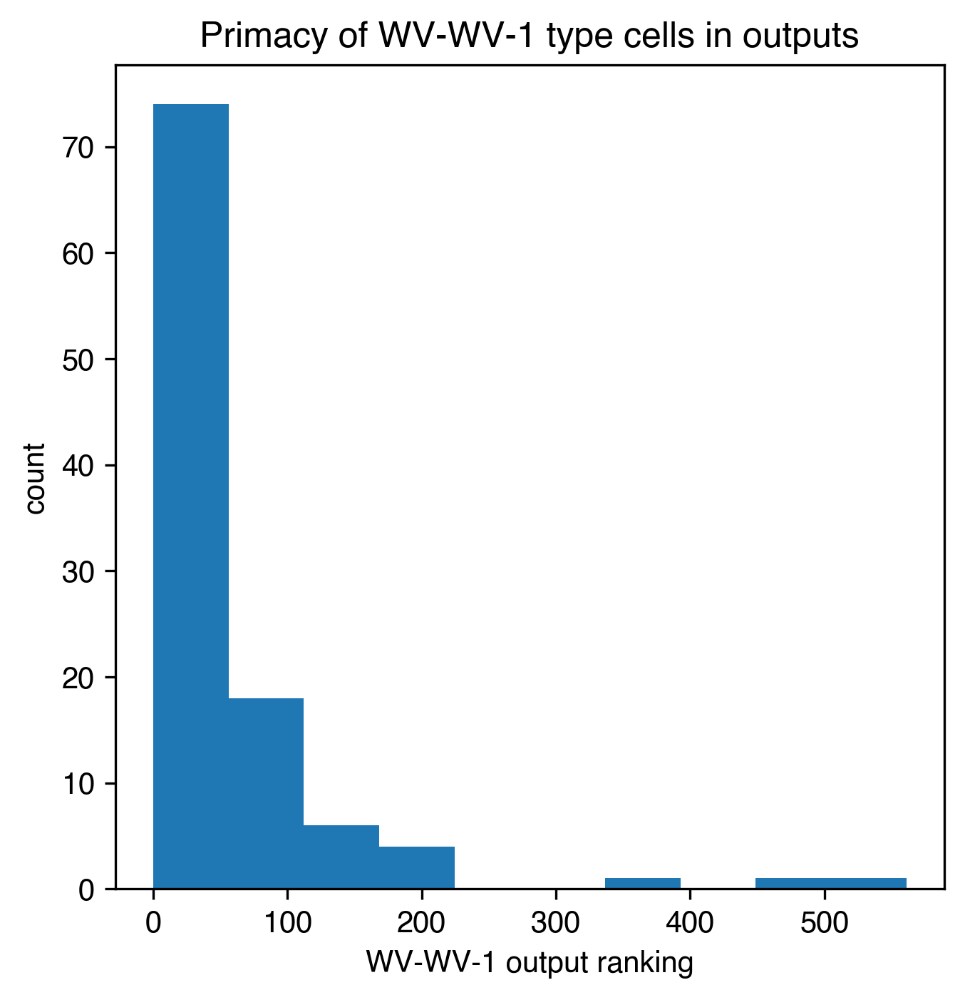

In [23]:
#create histogram of wvwv1 ranking distribution
#since NaN values are not plottable I am going to exclude them
wvwv1_ranks = primacy['wvwv1_rank'].dropna()

fig, ax = plt.subplots(figsize=(5,5))
plt.hist(wvwv1_ranks)
plt.title('Primacy of WV-WV-1 type cells in outputs')
ax.set_xlabel('WV-WV-1 output ranking')
ax.set_ylabel('count')

Text(0, 0.5, 'count')

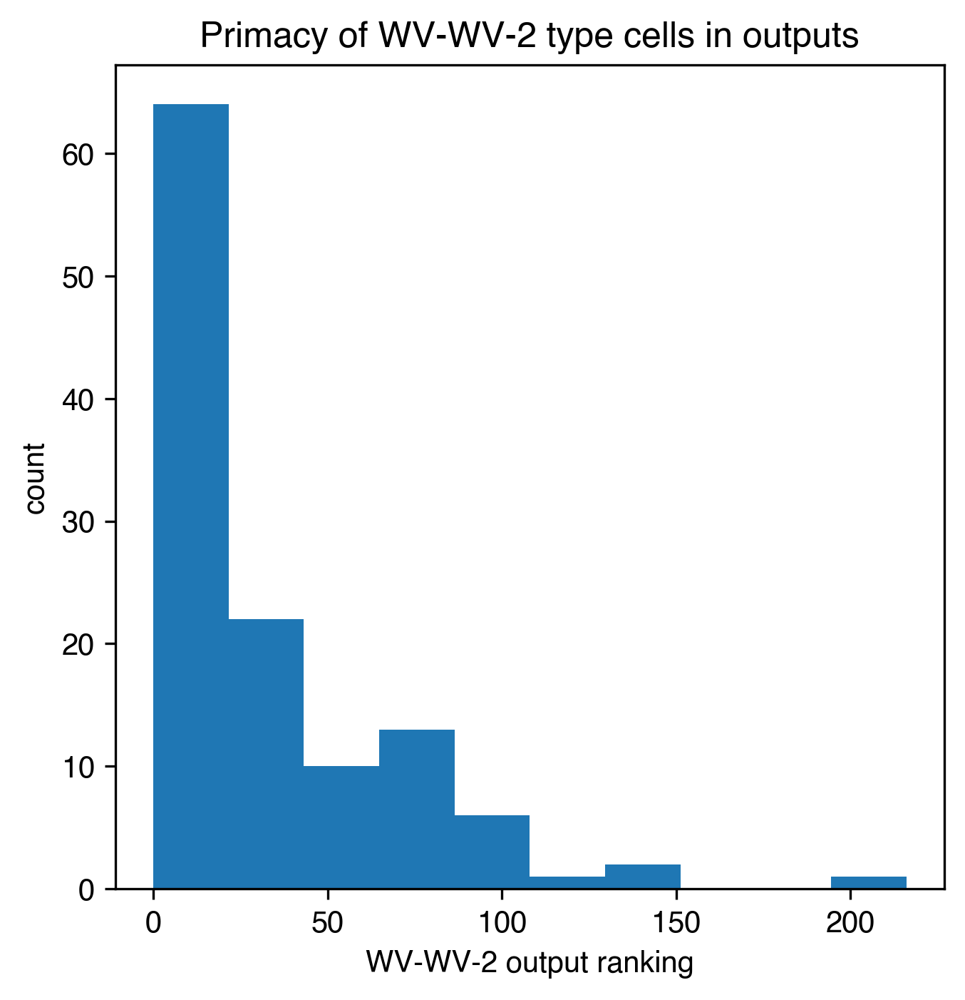

In [27]:
#create histogram of wvwv2 ranking distribution
#since NaN values are not plottable I am going to exclude them
wvwv2_ranks = primacy['wvwv2_rank'].dropna()

fig, ax = plt.subplots(figsize=(5,5))
plt.hist(wvwv2_ranks)
plt.title('Primacy of WV-WV-2 type cells in outputs')
ax.set_xlabel('WV-WV-2 output ranking')
ax.set_ylabel('count')

Text(0, 0.5, 'count')

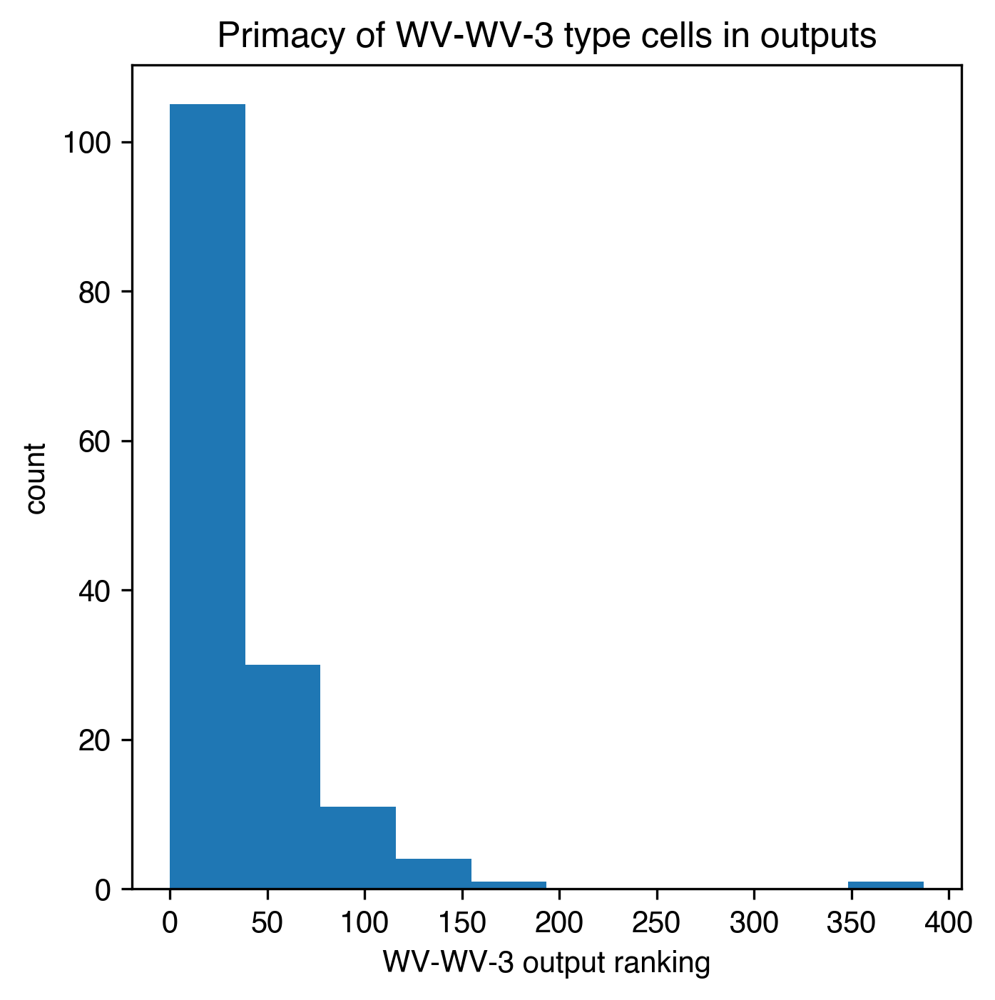

In [28]:
#create histogram of wvwv3 ranking distribution
#since NaN values are not plottable I am going to exclude them
wvwv3_ranks = primacy['wvwv3_rank'].dropna()

fig, ax = plt.subplots(figsize=(5,5))
plt.hist(wvwv3_ranks)
plt.title('Primacy of WV-WV-3 type cells in outputs')
ax.set_xlabel('WV-WV-3 output ranking')
ax.set_ylabel('count')

Text(0, 0.5, 'count')

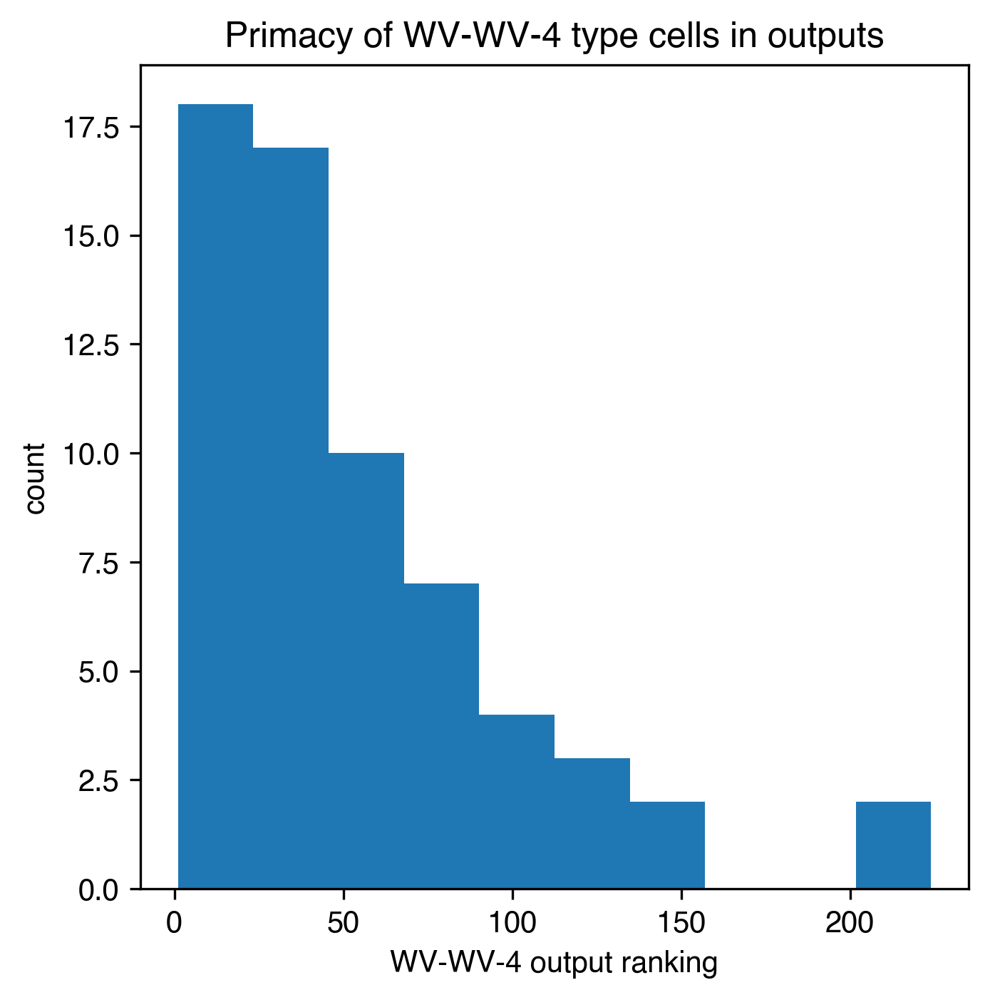

In [29]:
#create histogram of wvwv4 ranking distribution
#since NaN values are not plottable I am going to exclude them
wvwv4_ranks = primacy['wvwv4_rank'].dropna()

fig, ax = plt.subplots(figsize=(5,5))
plt.hist(wvwv4_ranks)
plt.title('Primacy of WV-WV-4 type cells in outputs')
ax.set_xlabel('WV-WV-4 output ranking')
ax.set_ylabel('count')

### Individual primacy analyses for each subtype with strong/weak distinction

Each subtype's input synapse counts differ greatly, so thresholds are going to be individually set based on subtype

In [30]:
#standard bins used for all histograms in order to compare scale

bins = np.arange(0, 400, 10)

In [31]:
#function for finding top 25% strongest inputs for a given subtype

def find_top25_threshold(input_conns_df): #start with ungrouped table of input connections to a given subtype
    #group table first by input cell type, sum synapse counts, sort in descending order
    conns_grouped = input_conns_df.groupby(['type_pre'], as_index=False).sum().sort_values(by='syn_count', ascending=False)
    #find top 25 conns by cell type by calculating top 25% for this specific subtype
    top25percent = conns_grouped.head(round(len(conns_grouped)*0.25))
    #find threshold by taking lowest value on top 25 df
    threshold = top25percent.tail(1)['syn_count'].item()
    return threshold

#### WV-WV-1

In [32]:
#find threshold for top 25% connections using function

wv1_threshold = find_top25_threshold(wvwv_inputs[wvwv_inputs['type_post']=='WV-WV-1'])
wv1_threshold

81

In [33]:
#filter primacy df for wvwv1 with value above

strong1_ranks = primacy[primacy['wvwv1_syncount']>=wv1_threshold]['wvwv1_rank']
weak1_ranks = primacy[primacy['wvwv1_syncount']<wv1_threshold]['wvwv1_rank']

(0.0, 50.0)

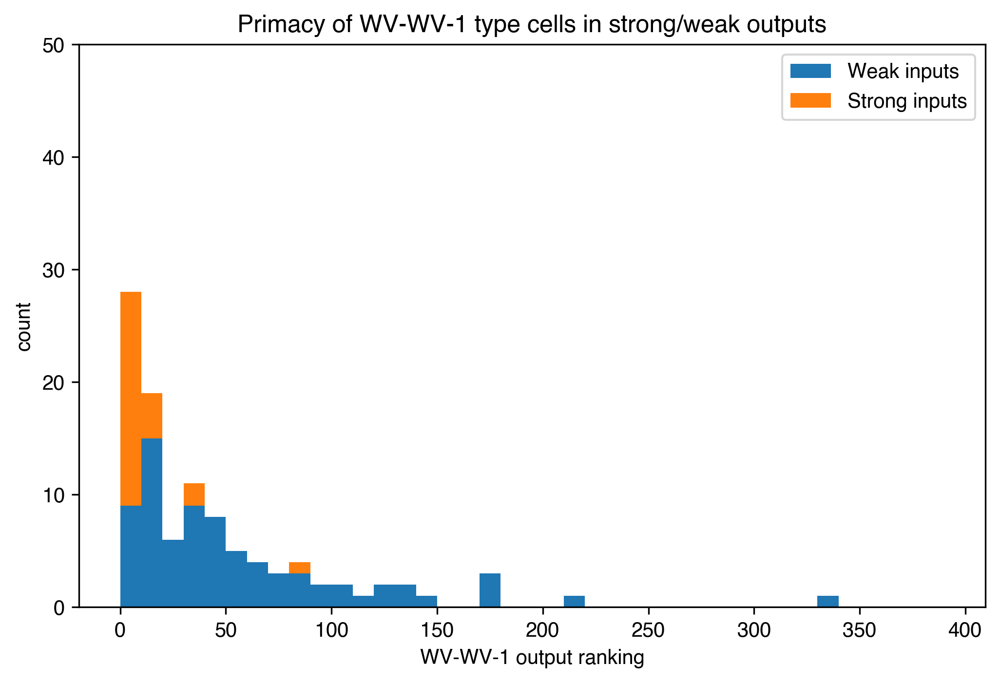

In [34]:
#wv-wv-1

fig, ax = plt.subplots(figsize=(8, 5))
plt.hist([weak1_ranks, strong1_ranks], bins=(bins), stacked=True)
plt.title('Primacy of WV-WV-1 type cells in strong/weak outputs')
ax.set_xlabel('WV-WV-1 output ranking')
ax.set_ylabel('count')
ax.legend(labels=['Weak inputs', 'Strong inputs'])
plt.ylim(0, 50)

#### WV-WV-2

In [35]:
#repeat the same process for wv-wv-1

wv2_threshold = find_top25_threshold(wvwv_inputs[wvwv_inputs['type_post']=='WV-WV-2'])
wv2_threshold

118

In [36]:
#separate rankings by connection strength
strong2_ranks = primacy[primacy['wvwv2_syncount']>=wv2_threshold]['wvwv2_rank']
weak2_ranks = primacy[primacy['wvwv2_syncount']<wv2_threshold]['wvwv2_rank']

(0.0, 50.0)

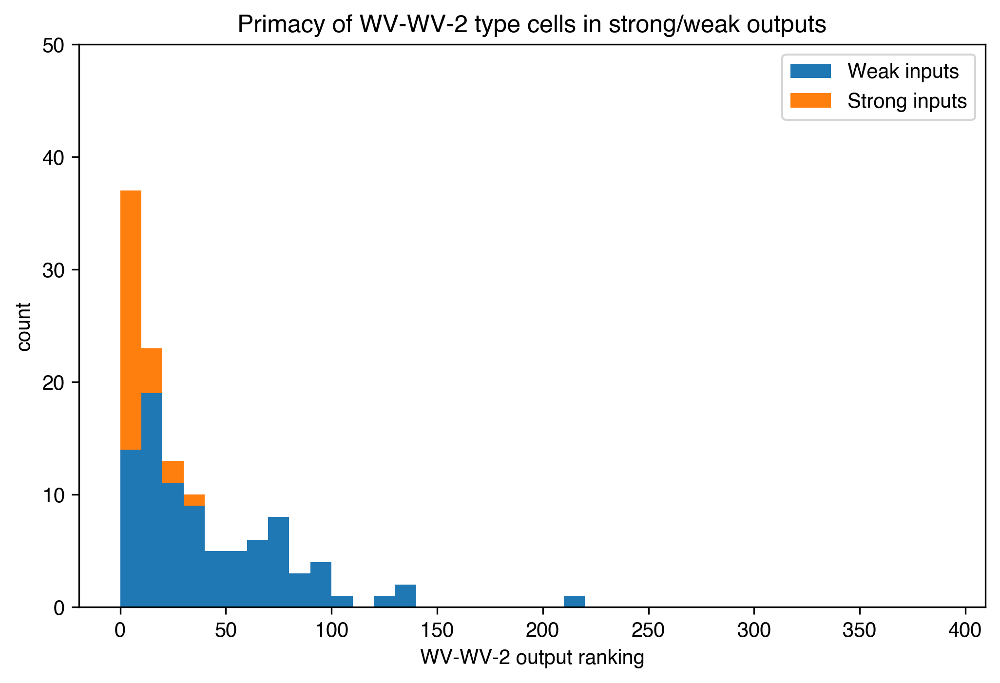

In [37]:
#wv-wv-2

fig, ax = plt.subplots(figsize=(8, 5))
plt.hist([weak2_ranks, strong2_ranks], bins=bins, stacked=True)
plt.title('Primacy of WV-WV-2 type cells in strong/weak outputs')
ax.set_xlabel('WV-WV-2 output ranking')
ax.set_ylabel('count')
ax.legend(labels=['Weak inputs', 'Strong inputs'])
plt.ylim(0, 50)

#### WV-WV-3

In [38]:
#wv-wv-3

wv3_threshold = find_top25_threshold(wvwv_inputs[wvwv_inputs['type_post']=='WV-WV-3'])
strong3_ranks = primacy[primacy['wvwv3_syncount']>=wv3_threshold]['wvwv3_rank']
weak3_ranks = primacy[primacy['wvwv3_syncount']<wv3_threshold]['wvwv3_rank']

(0.0, 50.0)

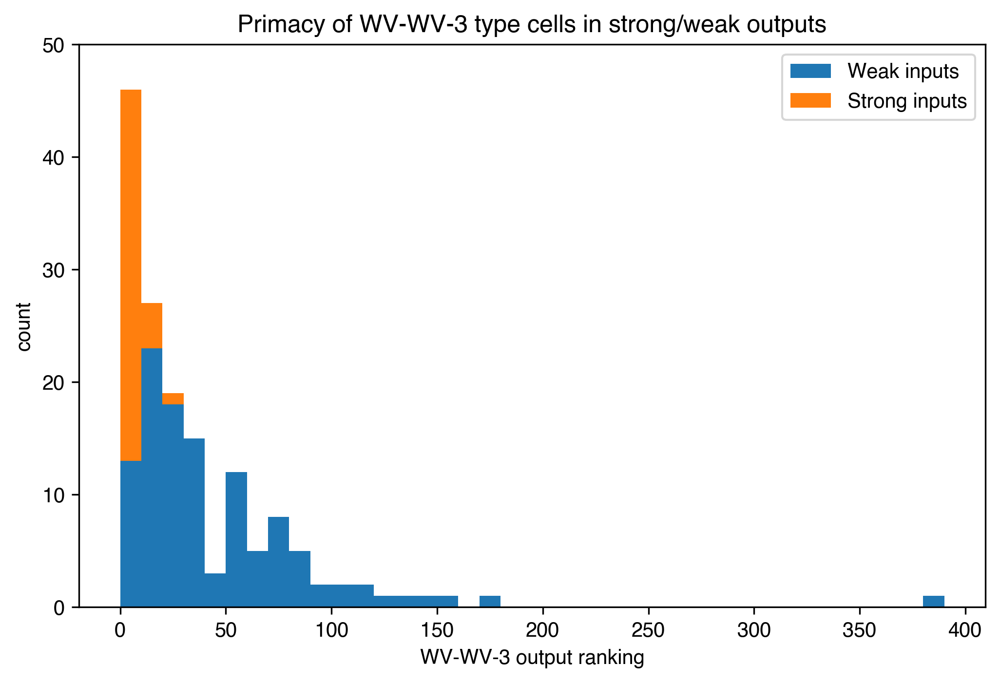

In [39]:
fig, ax = plt.subplots(figsize=(8, 5))
plt.hist([weak3_ranks, strong3_ranks], bins=bins, stacked=True)
plt.title('Primacy of WV-WV-3 type cells in strong/weak outputs')
ax.set_xlabel('WV-WV-3 output ranking')
ax.set_ylabel('count')
ax.legend(labels=['Weak inputs', 'Strong inputs'])
plt.ylim(0, 50)

#### WV-WV-4

In [40]:
#wv-wv-4

wv4_threshold = find_top25_threshold(wvwv_inputs[wvwv_inputs['type_post']=='WV-WV-4'])
strong4_ranks = primacy[primacy['wvwv4_syncount']>=wv4_threshold]['wvwv4_rank']
weak4_ranks = primacy[primacy['wvwv4_syncount']<wv4_threshold]['wvwv4_rank']

(0.0, 50.0)

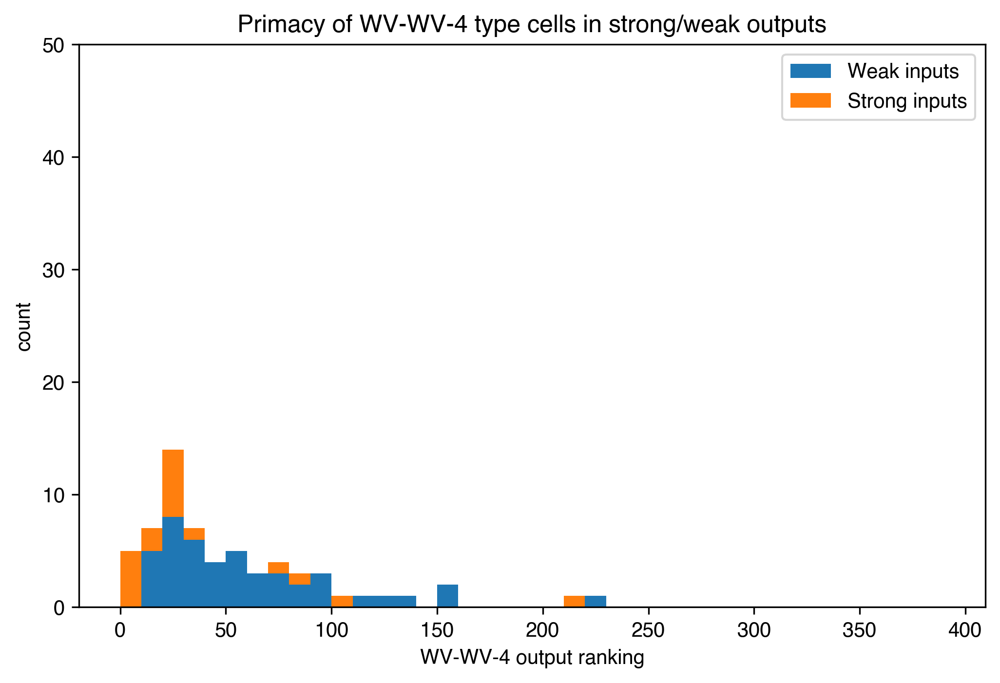

In [41]:
fig, ax = plt.subplots(figsize=(8, 5))
plt.hist([weak4_ranks, strong4_ranks], bins=bins, stacked=True)
plt.title('Primacy of WV-WV-4 type cells in strong/weak outputs')
ax.set_xlabel('WV-WV-4 output ranking')
ax.set_ylabel('count')
ax.legend(labels=['Weak inputs', 'Strong inputs'])
plt.ylim(0, 50)

## Distributions of WV-WV rankings within top 10

In [42]:
import matplotlib as mpl

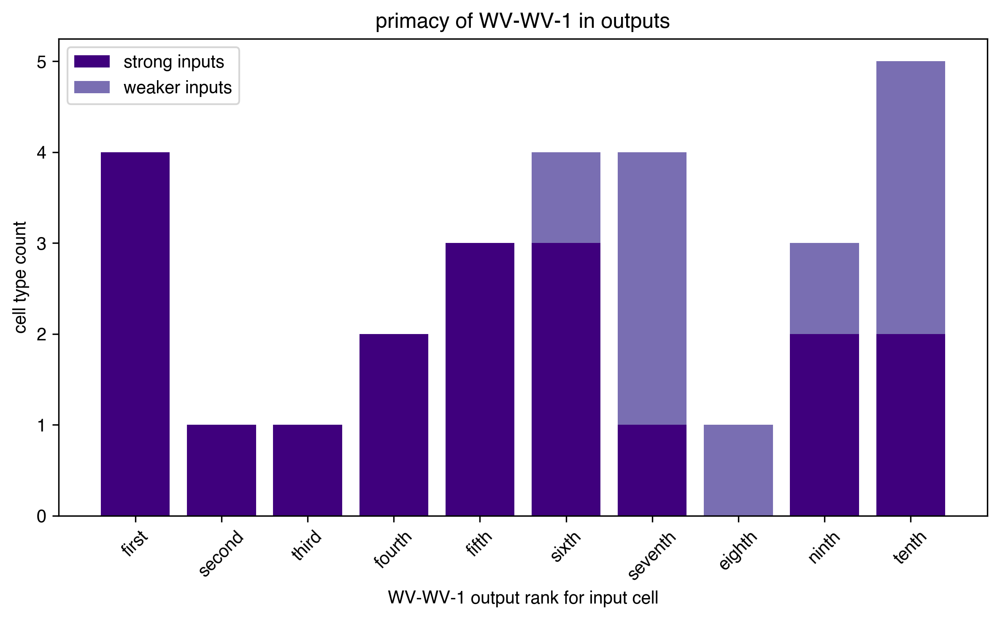

In [43]:
#wv-wv-1

cmap = mpl.colormaps['Purples'].resampled(4).reversed()

strong_counts, strong_bins = np.histogram(strong1_ranks, bins=np.arange(-0.5, 10, 1))
weak_counts, weak_bins = np.histogram(weak1_ranks, bins=np.arange(-0.5, 10, 1))
bins = np.arange(0, 10, 1)

fig, ax = plt.subplots(figsize=(8, 5))
ax.bar(bins, strong_counts, color=cmap([0]))
ax.bar(bins, weak_counts, color=cmap([1]), bottom=strong_counts)
ax.set_ylabel('cell type count')
ax.set_xlabel('WV-WV-1 output rank for input cell')
ax.set_xticks(bins)
ax.set_xticklabels(['first', 'second', 'third', 'fourth', 'fifth', 'sixth', 'seventh', 'eighth', 'ninth', 'tenth'],
                   rotation=45)
ax.legend(['strong inputs', 'weaker inputs'])
plt.title('primacy of WV-WV-1 in outputs')

fig.tight_layout()
plt.show()

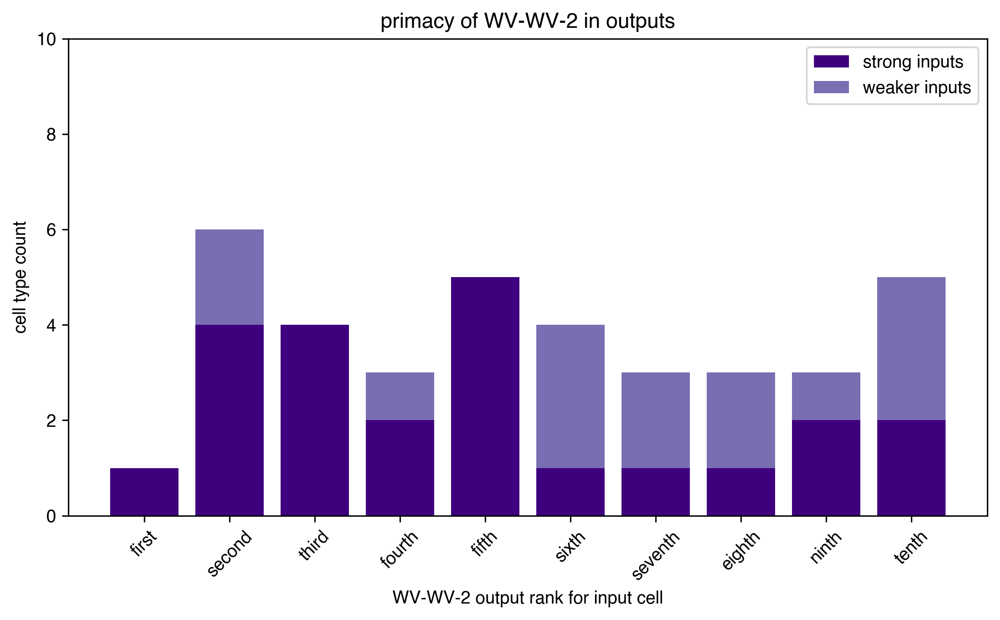

In [44]:
#wv-wv-2

cmap = mpl.colormaps['Purples'].resampled(4).reversed()

strong_counts, strong_bins = np.histogram(strong2_ranks, bins=np.arange(-0.5, 10, 1))
weak_counts, weak_bins = np.histogram(weak2_ranks, bins=np.arange(-0.5, 10, 1))
bins = np.arange(0, 10, 1)

fig, ax = plt.subplots(figsize=(8, 5))
ax.bar(bins, strong_counts, color=cmap([0]))
ax.bar(bins, weak_counts, color=cmap([1]), bottom=strong_counts)
ax.set_ylabel('cell type count')
ax.set_xlabel('WV-WV-2 output rank for input cell')
ax.set_xticks(bins)
ax.set_xticklabels(['first', 'second', 'third', 'fourth', 'fifth', 'sixth', 'seventh', 'eighth', 'ninth', 'tenth'],
                   rotation=45)
ax.legend(['strong inputs', 'weaker inputs'])
plt.title('primacy of WV-WV-2 in outputs')
plt.ylim(0, 10)

fig.tight_layout()
plt.show()

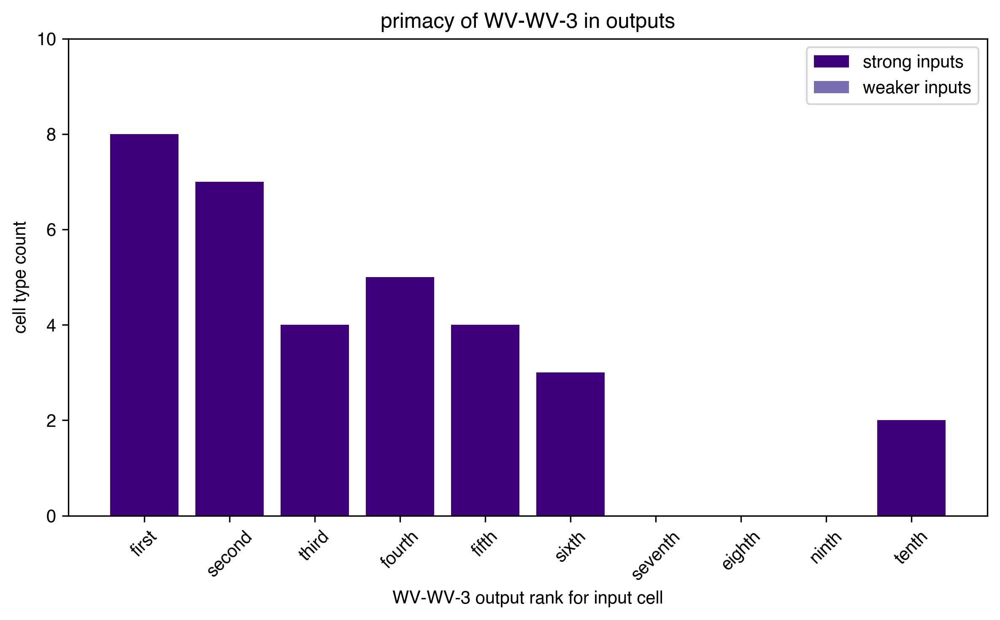

In [45]:
#wv-wv-3

cmap = mpl.colormaps['Purples'].resampled(4).reversed()

strong_counts, strong_bins = np.histogram(strong3_ranks, bins=np.arange(-0.5, 10, 1))
weak_counts, weak_bins = np.histogram(weak4_ranks, bins=np.arange(-0.5, 10, 1))
bins = np.arange(0, 10, 1)

fig, ax = plt.subplots(figsize=(8, 5))
ax.bar(bins, strong_counts, color=cmap([0]))
ax.bar(bins, weak_counts, color=cmap([1]), bottom=strong_counts)
ax.set_ylabel('cell type count')
ax.set_xlabel('WV-WV-3 output rank for input cell')
ax.set_xticks(bins)
ax.set_xticklabels(['first', 'second', 'third', 'fourth', 'fifth', 'sixth', 'seventh', 'eighth', 'ninth', 'tenth'],
                   rotation=45)
ax.legend(['strong inputs', 'weaker inputs'])
plt.title('primacy of WV-WV-3 in outputs')
plt.ylim(0, 10)

fig.tight_layout()
plt.show()

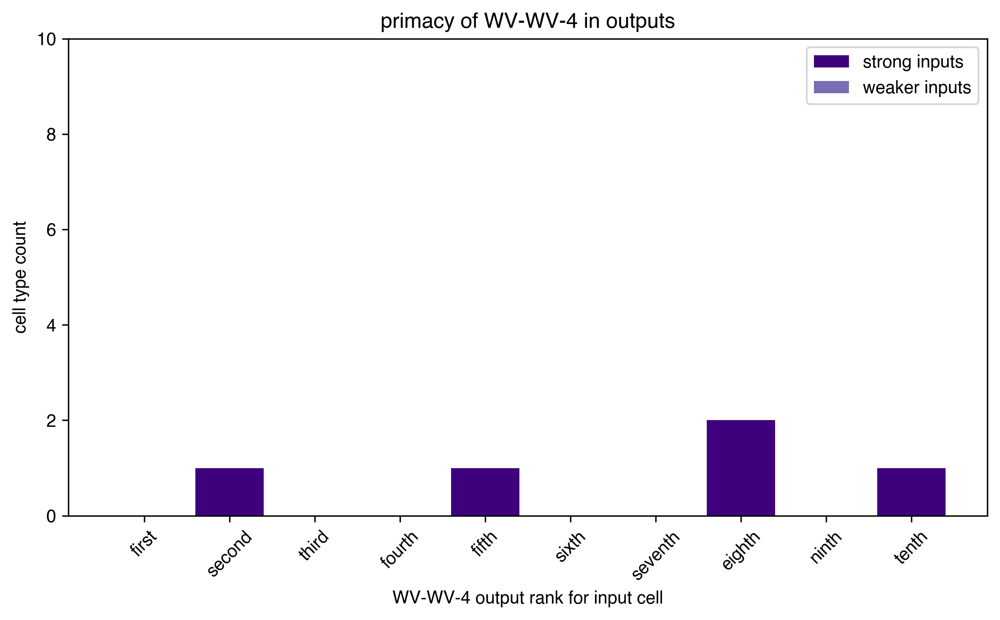

In [46]:
#wv-wv-4

cmap = mpl.colormaps['Purples'].resampled(4).reversed()

strong_counts, strong_bins = np.histogram(strong4_ranks, bins=np.arange(-0.5, 10, 1))
weak_counts, weak_bins = np.histogram(weak4_ranks, bins=np.arange(-0.5, 10, 1))
bins = np.arange(0, 10, 1)

fig, ax = plt.subplots(figsize=(8, 5))
ax.bar(bins, strong_counts, color=cmap([0]))
ax.bar(bins, weak_counts, color=cmap([1]), bottom=strong_counts)
ax.set_ylabel('cell type count')
ax.set_xlabel('WV-WV-4 output rank for input cell')
ax.set_xticks(bins)
ax.set_xticklabels(['first', 'second', 'third', 'fourth', 'fifth', 'sixth', 'seventh', 'eighth', 'ninth', 'tenth'],
                   rotation=45)
ax.legend(['strong inputs', 'weaker inputs'])
plt.title('primacy of WV-WV-4 in outputs')
plt.ylim(0, 1.5)
plt.ylim(0, 10)

fig.tight_layout()
plt.show()

## Looking only at primacy of strong connections
First plot histogram of only strong connections for each subtype to see where rankings stand -- keep in mind that 'strong' means inputs with synapse counts in the top 25% (out of all inputs grouped by cell type) for each subtype respectively.

Text(0, 0.5, '# of cell types')

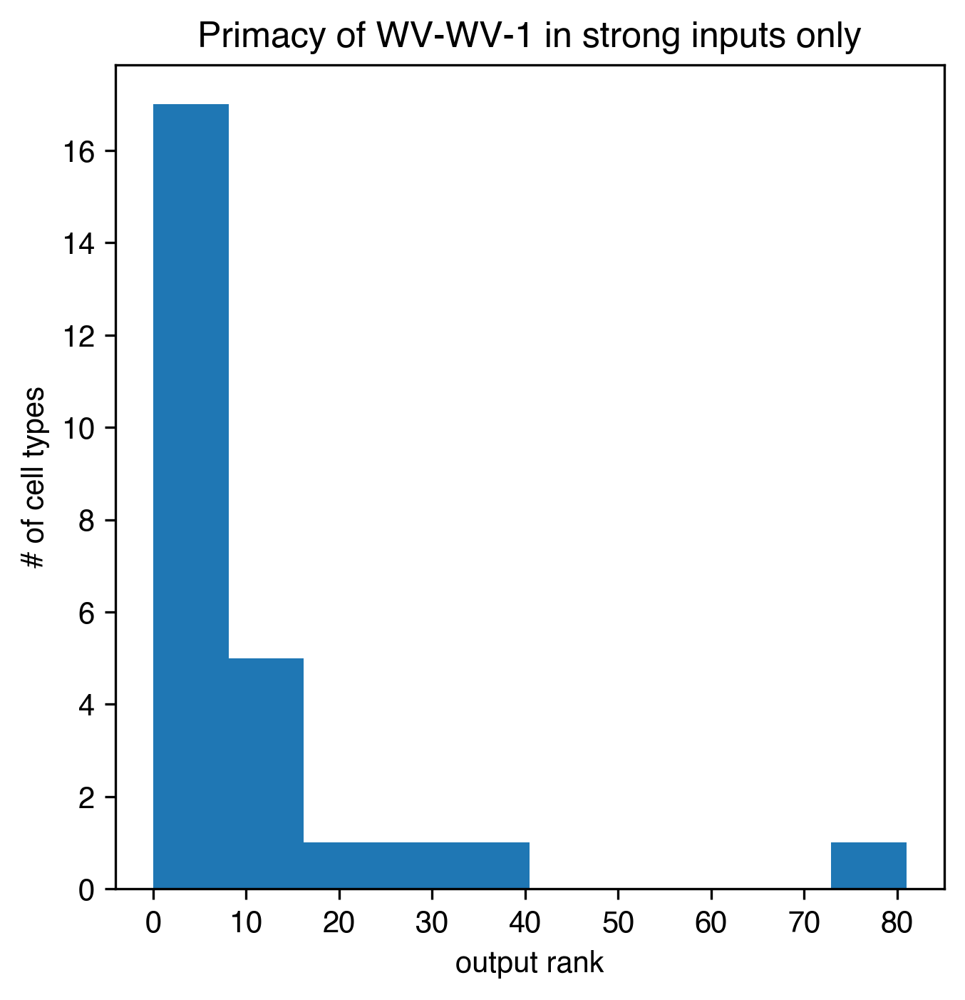

In [47]:
#wv-wv-1

fig, ax = plt.subplots(figsize=(5,5))
plt.hist(strong1_ranks)
plt.title('Primacy of WV-WV-1 in strong inputs only')
ax.set_xlabel('output rank')
ax.set_ylabel('# of cell types')

Text(0, 0.5, '# of cell types')

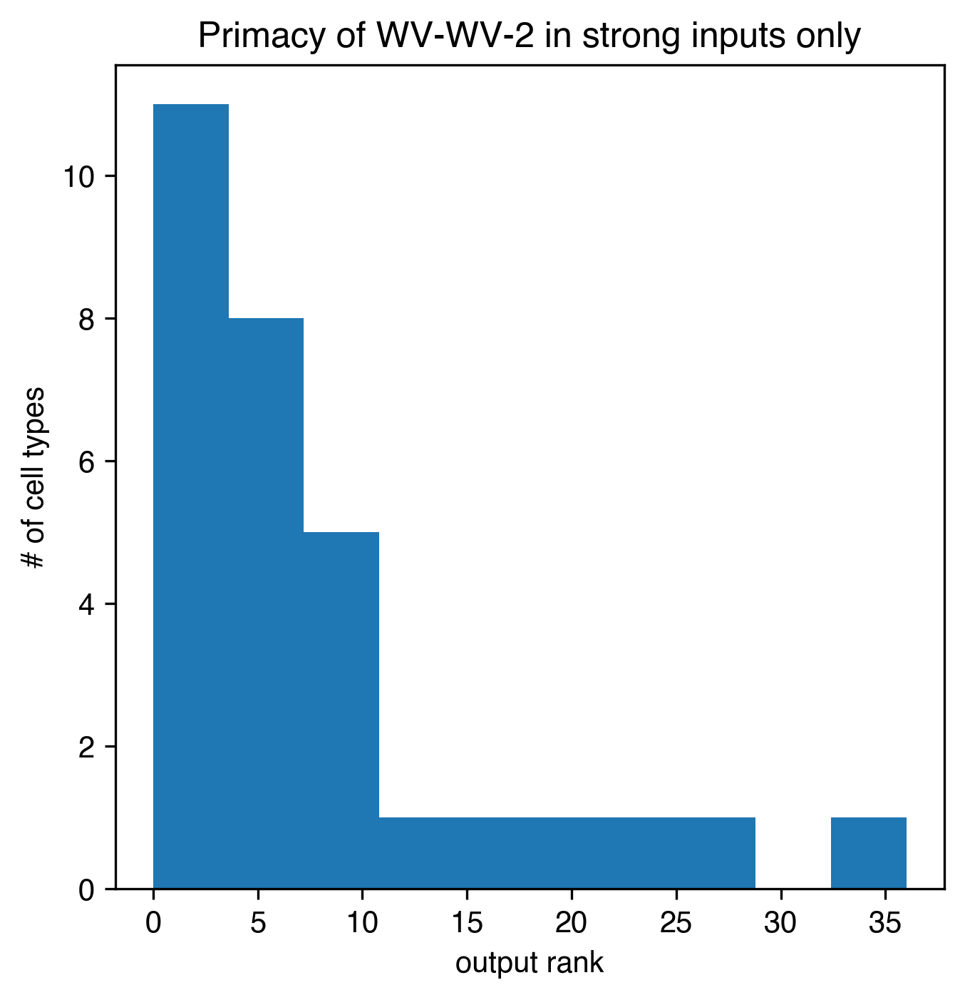

In [48]:
#wv-wv-2

fig, ax = plt.subplots(figsize=(5, 5))
plt.hist(strong2_ranks)
plt.title('Primacy of WV-WV-2 in strong inputs only')
ax.set_xlabel('output rank')
ax.set_ylabel('# of cell types')

Text(0, 0.5, '# of cell types')

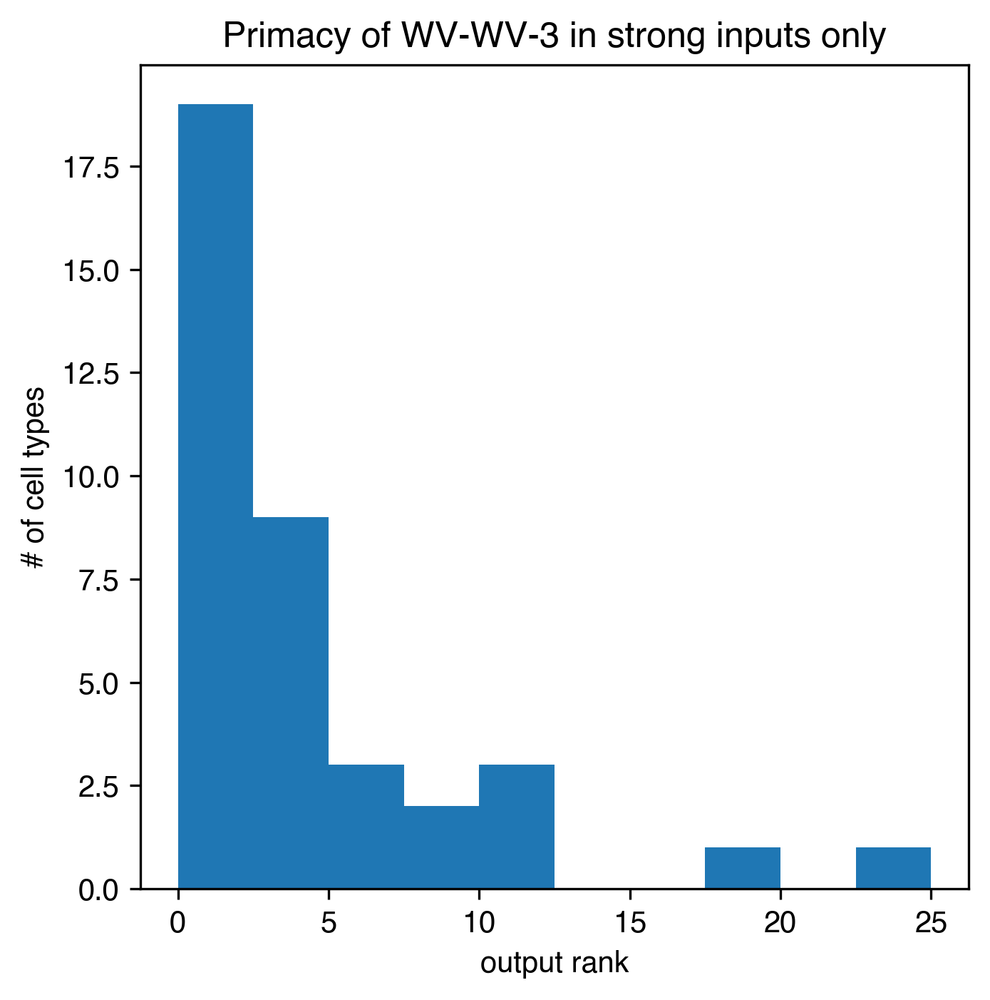

In [49]:
#wv-wv-3

fig, ax = plt.subplots(figsize=(5, 5))
plt.hist(strong3_ranks)
plt.title('Primacy of WV-WV-3 in strong inputs only')
ax.set_xlabel('output rank')
ax.set_ylabel('# of cell types')

Text(0, 0.5, '# of cell types')

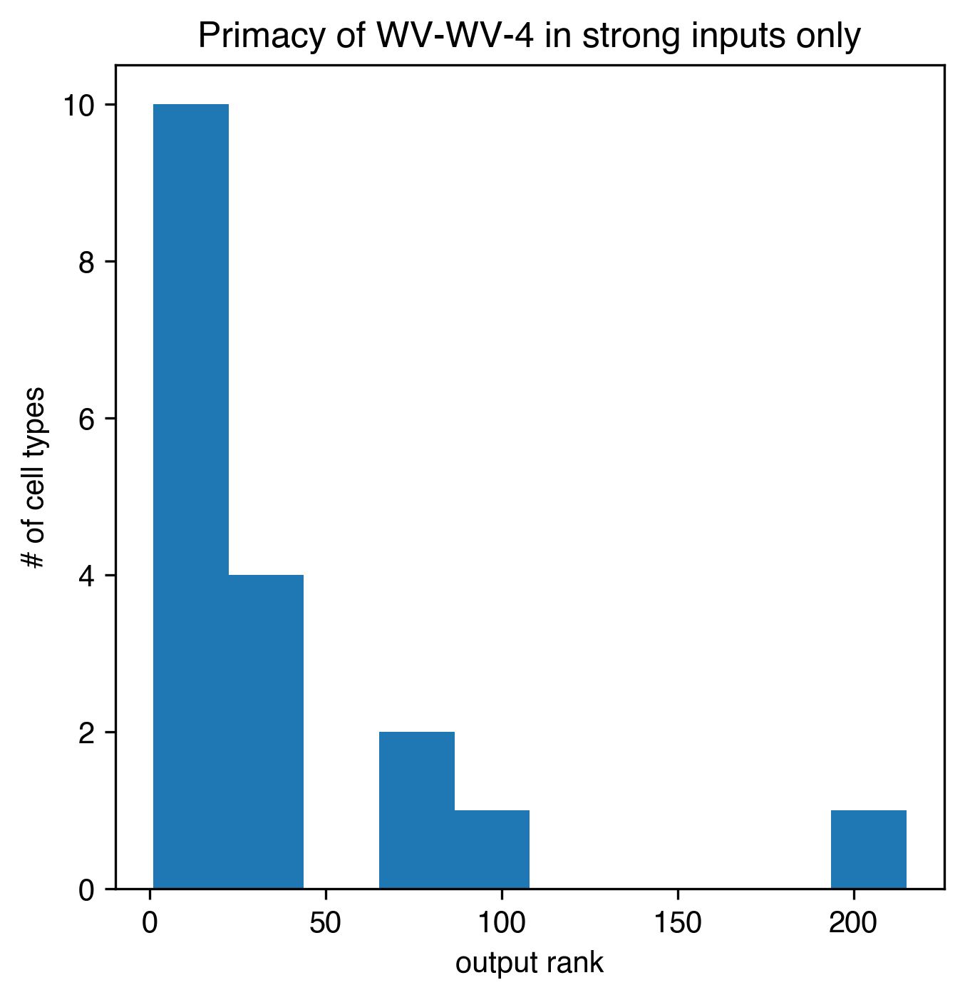

In [50]:
#wv-wv-4

fig, ax = plt.subplots(figsize=(5, 5))
plt.hist(strong4_ranks)
plt.title('Primacy of WV-WV-4 in strong inputs only')
ax.set_xlabel('output rank')
ax.set_ylabel('# of cell types')

## Comparing connections within and outside the auditory system -- cells where wv-wvs rank within top 10 (Stacked bars)

In [51]:
#create grouped bar charts for auditory vs non auditory inputs
aud_vs_nonaud_outputs = wvwv_outputs.pivot_table(
    index='type_pre',
    columns='class_post',
    values='syn_count',
    aggfunc='sum'
).reset_index()

aud_vs_nonaud_outputs

class_post,type_pre,auditory,non-auditory
0,WV-WV-1,7165,11431
1,WV-WV-2,3297,14859
2,WV-WV-3,4873,9350
3,WV-WV-4,664,1600


In [53]:
#do the same thing but for inputs
aud_vs_nonaud_inputs = wvwv_inputs.pivot_table(
    index='type_post',
    columns='class_pre',
    values='syn_count',
    aggfunc='sum'
).reset_index()
aud_vs_nonaud_inputs

class_pre,type_post,auditory,non-auditory
0,WV-WV-1,11194,5865
1,WV-WV-2,8430,8714
2,WV-WV-3,8849,11873
3,WV-WV-4,797,1032


(0.0, 18000.0)

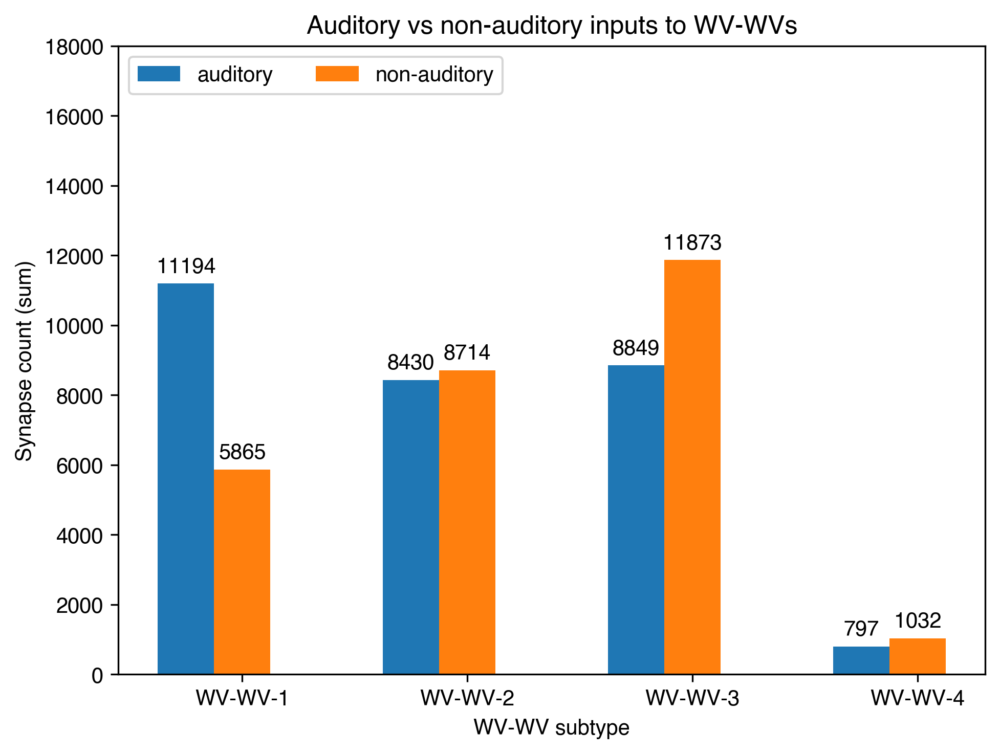

In [54]:
#make grouped bar chart for inputs

x = np.arange(len(aud_vs_nonaud_inputs['type_post']))
width = 0.25
multiplier = 0

fig, ax = plt.subplots(layout='constrained')

for attribute, value in aud_vs_nonaud_inputs[['auditory', 'non-auditory']].items():
    offset = width * multiplier
    rects = ax.bar(x + offset, value, width, label=attribute)
    ax.bar_label(rects, padding=3)
    multiplier +=1

ax.set_ylabel('Synapse count (sum)')
ax.set_xlabel('WV-WV subtype')
ax.set_title('Auditory vs non-auditory inputs to WV-WVs')
ax.set_xticks(x + width, aud_vs_nonaud_inputs['type_post'])
ax.legend(loc='upper left', ncols=3)
ax.set_ylim(0, 18000)


(0.0, 18000.0)

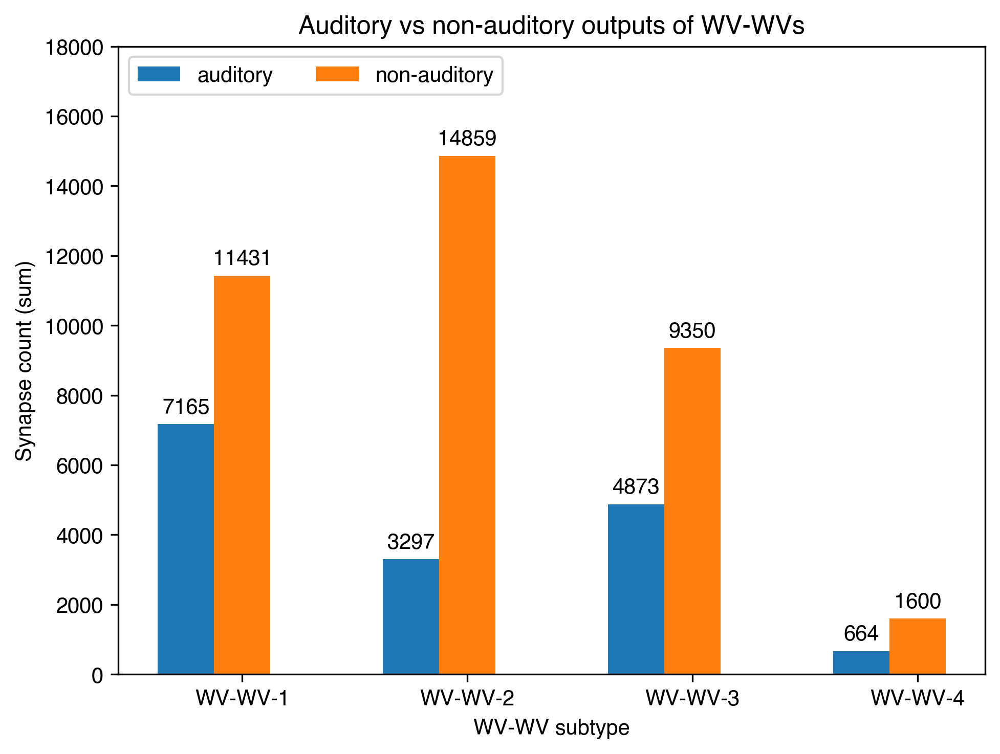

In [55]:
#do the same thing for outputs

x = np.arange(len(aud_vs_nonaud_outputs['type_pre']))
width = 0.25
multiplier = 0

fig, ax = plt.subplots(layout='constrained')

for attribute, value in aud_vs_nonaud_outputs[['auditory', 'non-auditory']].items():
    offset = width * multiplier
    rects = ax.bar(x + offset, value, width, label=attribute)
    ax.bar_label(rects, padding=3)
    multiplier +=1

ax.set_ylabel('Synapse count (sum)')
ax.set_xlabel('WV-WV subtype')
ax.set_title('Auditory vs non-auditory outputs of WV-WVs')
ax.set_xticks(x + width, aud_vs_nonaud_outputs['type_pre'])
ax.legend(loc='upper left', ncols=3)
ax.set_ylim(0, 18000)


## Primacy analyses with auditory/non-auditory distinction
What is the distribution of output ranks for each subtype among strong connections only? How many inputs are from the auditory system? How many are from elsewhere?

In [56]:
#primacy for inputs within the auditory system
#also filter out connections lower than 5 with threshold

inputswithclass_abovethresh = wvwv_inputs[wvwv_inputs['syn_count']>=5]
inputswithclass_abovethresh

,pre_root_id,post_root_id,syn_count,nt_type,type_pre,type_post,pref_pre,pref_post,class_pre,class_post
2141,720575940622996579,720575940627201579,252,GLUT,DNg40,WV-WV-3,NaN,NaN,non-auditory,auditory
2741,720575940626901136,720575940627201579,236,GLUT,DNg40,WV-WV-3,NaN,NaN,non-auditory,auditory
4618,720575940624750480,720575940635330204,203,GABA,DNg24,WV-WV-1,NaN,NaN,non-auditory,auditory
5100,720575940605214636,720575940621717469,196,GABA,WV-WV-3,WV-WV-3,NaN,NaN,auditory,auditory
5116,720575940639118926,720575940605214636,196,GABA,DNg24,WV-WV-3,NaN,NaN,non-auditory,auditory
...,...,...,...,...,...,...,...,...,...,...
3709886,720575940623292713,720575940634571383,5,GABA,SAD_pr02,WV-WV-2,sine,NaN,auditory,auditory
3715523,720575940623446860,720575940621717469,5,SER,DNg30,WV-WV-3,NaN,NaN,non-auditory,auditory
3723221,720575940622998115,720575940622123981,5,ACH,JO-B,WV-WV-1,NaN,NaN,auditory,auditory
3726672,720575940623197588,720575940603533246,5,ACH,CB2186,WV-WV-3,NaN,NaN,non-auditory,auditory


In [57]:
input_types_and_class = inputswithclass_abovethresh.groupby(['type_pre', 'class_pre'], as_index=False)[['syn_count']].sum() #group by presynaptic cell type and auditory/non-auditory class
input_types_and_class

,type_pre,class_pre,syn_count
0,A2,auditory,366
1,AMMC-A1,auditory,21
2,AN_AMMC_SAD_1,non-auditory,34
3,AN_AMMC_SAD_2,non-auditory,18
4,AN_AVLP_11,non-auditory,34
...,...,...,...
241,WV-WV-1,auditory,557
242,WV-WV-2,auditory,725
243,WV-WV-3,auditory,1094
244,WV-WV-4,auditory,88


In [58]:
#do the same primacy analysis as before but include class column for distinction down the line

class_primacy = input_types_and_class.copy()
class_primacy = class_primacy.rename(columns={'syn_count':'total_syn_count'}).sort_values(by='total_syn_count', ascending=False)
class_primacy

,type_pre,class_pre,total_syn_count
70,B1,auditory,13946
201,JO-A,auditory,6826
240,WED_pr02,auditory,2425
128,CB1948,non-auditory,1856
173,DNg40,non-auditory,1174
...,...,...,...
93,CB0979,non-auditory,5
175,DNg84,non-auditory,5
16,AN_AVLP_52,non-auditory,5
97,CB1044,non-auditory,5


In [59]:
#create ranking columns

class_primacy['wvwv1_rank'] = 0
class_primacy['wvwv2_rank'] = 0
class_primacy['wvwv3_rank'] = 0
class_primacy['wvwv4_rank'] = 0
class_primacy['wvwv1_syncount'] = 0
class_primacy['wvwv2_syncount'] = 0
class_primacy['wvwv3_syncount'] = 0
class_primacy['wvwv4_syncount'] = 0

class_primacy

,type_pre,class_pre,total_syn_count,wvwv1_rank,wvwv2_rank,wvwv3_rank,wvwv4_rank,wvwv1_syncount,wvwv2_syncount,wvwv3_syncount,wvwv4_syncount
70,B1,auditory,13946,0,0,0,0,0,0,0,0
201,JO-A,auditory,6826,0,0,0,0,0,0,0,0
240,WED_pr02,auditory,2425,0,0,0,0,0,0,0,0
128,CB1948,non-auditory,1856,0,0,0,0,0,0,0,0
173,DNg40,non-auditory,1174,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...
93,CB0979,non-auditory,5,0,0,0,0,0,0,0,0
175,DNg84,non-auditory,5,0,0,0,0,0,0,0,0
16,AN_AVLP_52,non-auditory,5,0,0,0,0,0,0,0,0
97,CB1044,non-auditory,5,0,0,0,0,0,0,0,0


In [60]:
#add values into columns

for idx, row in class_primacy.iterrows():
    #filter df to find all outputs for each given input cell type, then group by postsynaptic cell type, sum synapse counts, and sort in descending order
    outputs = conns_types[conns_types['type_pre']==row.type_pre].groupby('type_post', as_index=False)[['syn_count']].sum().sort_values(by=('syn_count'), ascending=False, ignore_index=True)
   
   #find ranking for each subtype in outputs column of output connections for each given input cell
    wvwv1 = outputs[outputs['type_post']=='WV-WV-1']
    if len(wvwv1) == 0: #if the input cell doesn't output to a given subtype, the row will = NaN
        class_primacy.loc[idx, 'wvwv1_rank'] = np.nan
        class_primacy.loc[idx, 'wvwv1_syncount'] = np.nan
    else: #if it does (which it likely will):
        class_primacy.loc[idx, 'wvwv1_rank'] = wvwv1.index.values[0] #add the rank in order of greatest syn count (of wvwv1 in this case) to df
        class_primacy.loc[idx, 'wvwv1_syncount'] = wvwv1['syn_count'].values[0] #add corresponding synapse count

    wvwv2 = outputs[outputs['type_post']=='WV-WV-2']
    if len(wvwv2) == 0:
        class_primacy.loc[idx, 'wvwv2_rank'] = np.nan
        class_primacy.loc[idx, 'wvwv2_syncount'] = np.nan
    else:
        class_primacy.loc[idx, 'wvwv2_rank'] = wvwv2.index.values[0]
        class_primacy.loc[idx, 'wvwv2_syncount'] = wvwv2['syn_count'].values[0]

    wvwv3 = outputs[outputs['type_post']=='WV-WV-3']
    if len(wvwv3) == 0:
        class_primacy.loc[idx, 'wvwv3_rank'] = np.nan
        class_primacy.loc[idx, 'wvwv3_syncount'] = np.nan
    else:
        class_primacy.loc[idx, 'wvwv3_rank'] = wvwv3.index.values[0]
        class_primacy.loc[idx, 'wvwv3_syncount'] = wvwv3['syn_count'].values[0]

    wvwv4 = outputs[outputs['type_post']=='WV-WV-4']
    if len(wvwv4) == 0:
        class_primacy.loc[idx, 'wvwv4_rank'] = np.nan
        class_primacy.loc[idx, 'wvwv4_syncount'] = np.nan
    else:
        class_primacy.loc[idx, 'wvwv4_rank'] = wvwv4.index.values[0]
        class_primacy.loc[idx, 'wvwv4_syncount'] = wvwv4['syn_count'].values[0]

class_primacy

,type_pre,class_pre,total_syn_count,wvwv1_rank,wvwv2_rank,wvwv3_rank,wvwv4_rank,wvwv1_syncount,wvwv2_syncount,wvwv3_syncount,wvwv4_syncount
70,B1,auditory,13946,3.0,2.0,11.0,215.0,5594.0,5601.0,2669.0,82.0
201,JO-A,auditory,6826,1.0,36.0,0.0,85.0,2990.0,296.0,3485.0,55.0
240,WED_pr02,auditory,2425,5.0,4.0,74.0,22.0,895.0,1182.0,47.0,301.0
128,CB1948,non-auditory,1856,5.0,1.0,0.0,NaN,285.0,717.0,854.0,NaN
173,DNg40,non-auditory,1174,35.0,63.0,0.0,23.0,14.0,5.0,1130.0,25.0
...,...,...,...,...,...,...,...,...,...,...,...
93,CB0979,non-auditory,5,NaN,42.0,NaN,NaN,NaN,5.0,NaN,NaN
175,DNg84,non-auditory,5,NaN,NaN,NaN,73.0,NaN,NaN,NaN,5.0
16,AN_AVLP_52,non-auditory,5,NaN,NaN,74.0,NaN,NaN,NaN,5.0,NaN
97,CB1044,non-auditory,5,NaN,74.0,NaN,NaN,NaN,5.0,NaN,NaN


Now create stacked hist for each subtype, but instead of strong/weak synsapses distinguish between auditory/non-auditory

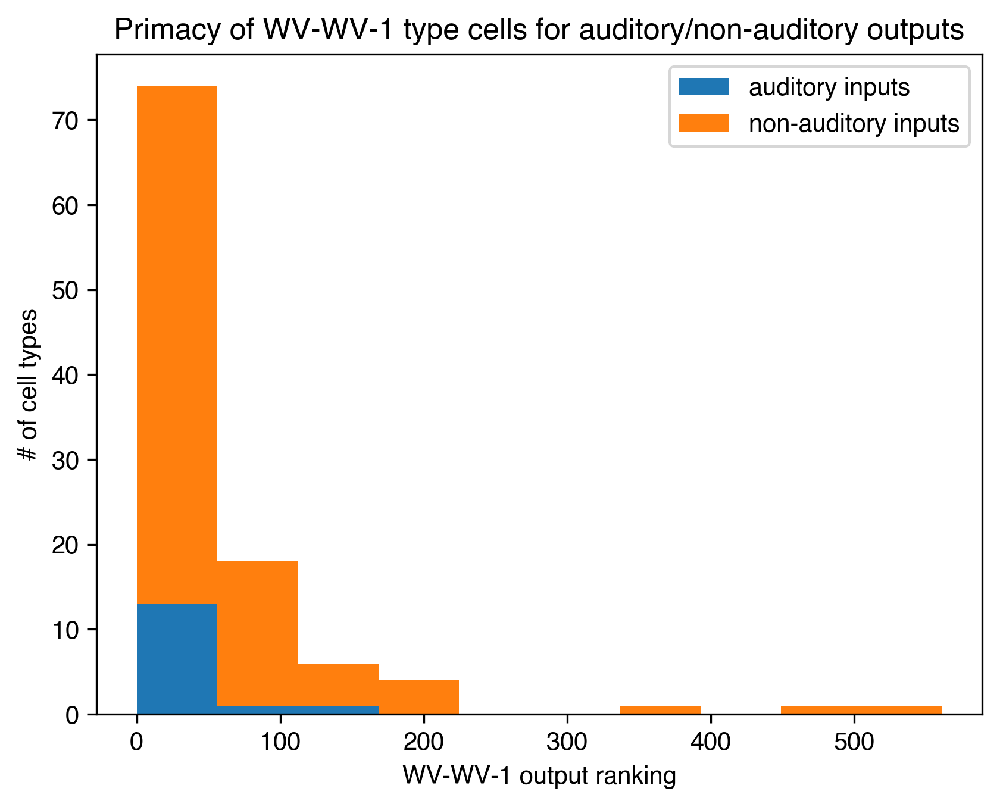

In [61]:
#wv-wv-1
wvwv1_aud_ranks = class_primacy[class_primacy['class_pre']=='auditory']['wvwv1_rank'].dropna()
wvwv1_nonaud_ranks = class_primacy[class_primacy['class_pre']=='non-auditory']['wvwv1_rank'].dropna()

fig, ax = plt.subplots()
plt.hist([wvwv1_aud_ranks, wvwv1_nonaud_ranks], stacked=True)
plt.title('Primacy of WV-WV-1 type cells for auditory/non-auditory outputs')
ax.set_xlabel('WV-WV-1 output ranking')
ax.set_ylabel('# of cell types')
ax.legend(labels=['auditory inputs', 'non-auditory inputs'])

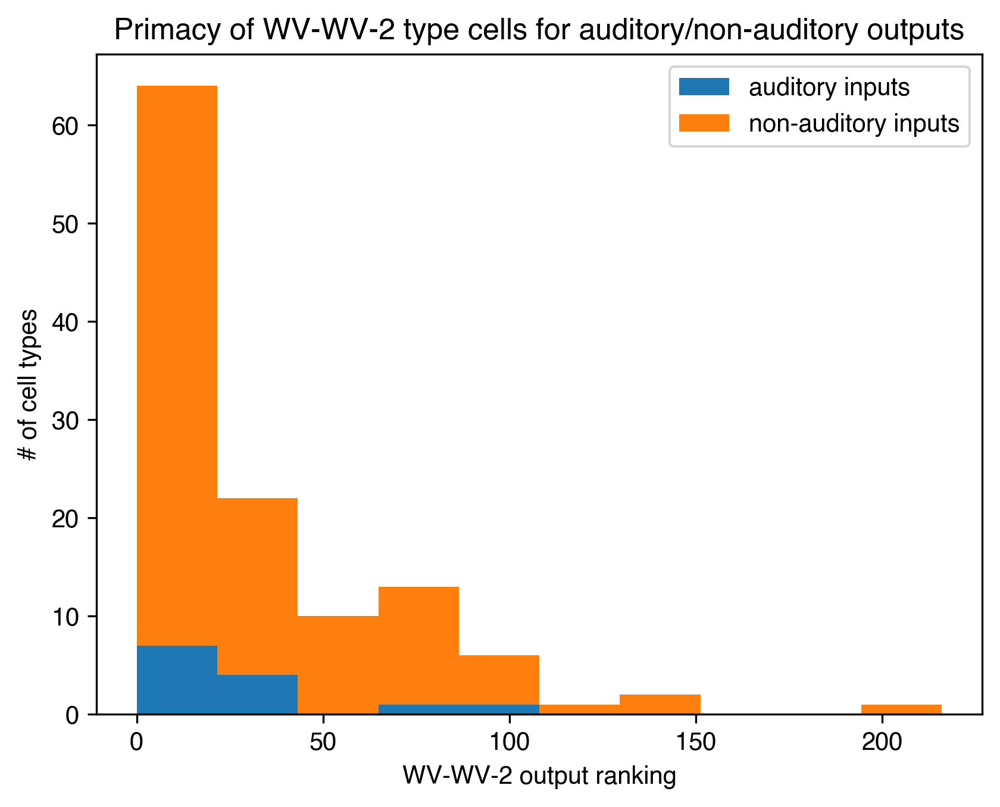

In [62]:
#wv-wv-2

wvwv2_aud_ranks = class_primacy[class_primacy['class_pre']=='auditory']['wvwv2_rank'].dropna()
wvwv2_nonaud_ranks = class_primacy[class_primacy['class_pre']=='non-auditory']['wvwv2_rank'].dropna()

fig, ax = plt.subplots()
plt.hist([wvwv2_aud_ranks, wvwv2_nonaud_ranks], stacked=True)
plt.title('Primacy of WV-WV-2 type cells for auditory/non-auditory outputs')
ax.set_xlabel('WV-WV-2 output ranking')
ax.set_ylabel('# of cell types')
ax.legend(labels=['auditory inputs', 'non-auditory inputs'])

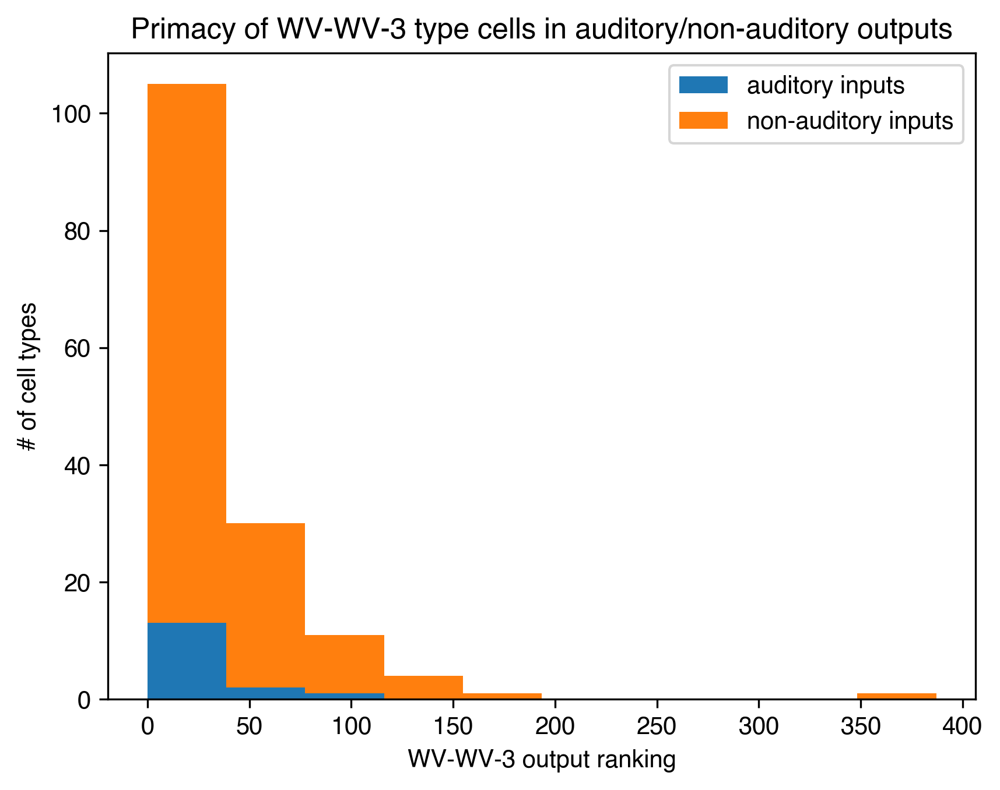

In [63]:
#wv-wv-3

wvwv3_aud_ranks = class_primacy[class_primacy['class_pre']=='auditory']['wvwv3_rank'].dropna()
wvwv3_nonaud_ranks = class_primacy[class_primacy['class_pre']=='non-auditory']['wvwv3_rank'].dropna()

fig, ax = plt.subplots()
plt.hist([wvwv3_aud_ranks, wvwv3_nonaud_ranks], stacked=True)
plt.title('Primacy of WV-WV-3 type cells in auditory/non-auditory outputs')
ax.set_xlabel('WV-WV-3 output ranking')
ax.set_ylabel('# of cell types')
ax.legend(labels=['auditory inputs', 'non-auditory inputs'])

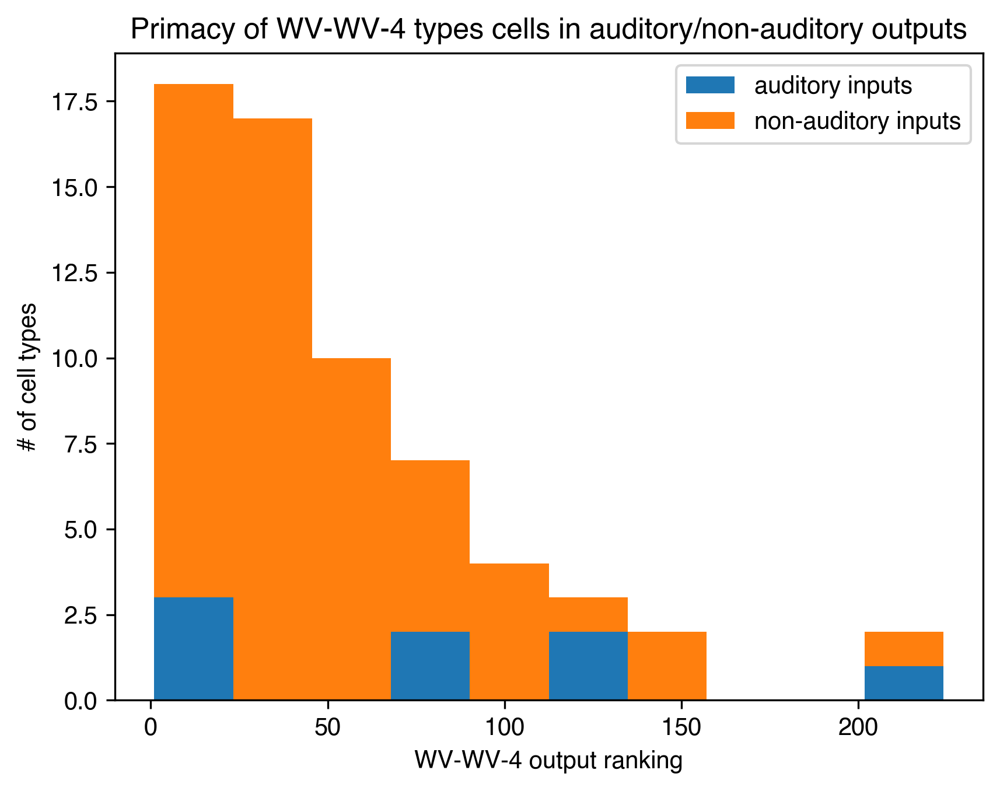

In [64]:
#wv-wv-4

wvwv4_aud_ranks = class_primacy[class_primacy['class_pre']=='auditory']['wvwv4_rank'].dropna()
wvwv4_nonaud_ranks = class_primacy[class_primacy['class_pre']=='non-auditory']['wvwv4_rank'].dropna()

fig, ax = plt.subplots()
plt.hist([wvwv4_aud_ranks, wvwv4_nonaud_ranks], stacked=True)
plt.title('Primacy of WV-WV-4 types cells in auditory/non-auditory outputs')
ax.set_xlabel('WV-WV-4 output ranking')
ax.set_ylabel('# of cell types')
ax.legend(labels=['auditory inputs', 'non-auditory inputs'])

Set standard bins to each figure so that the scales are the same for easier comparison

(0.0, 50.0)

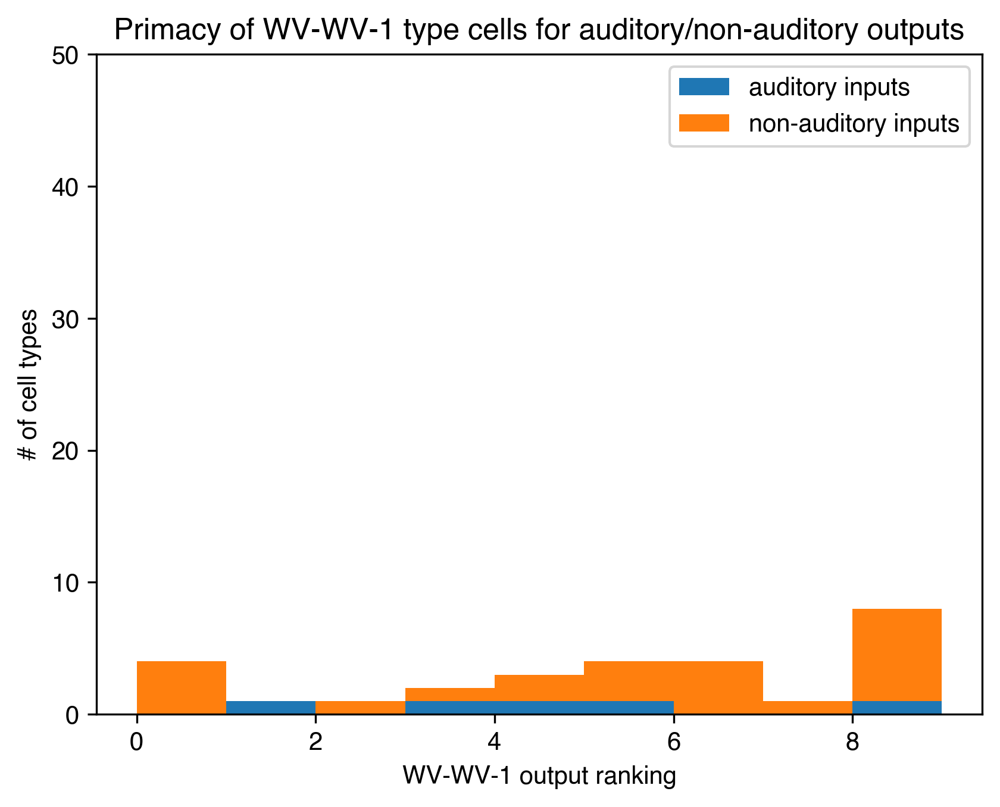

In [65]:
#wv-wv-1
wvwv1_aud_ranks = class_primacy[class_primacy['class_pre']=='auditory']['wvwv1_rank'].dropna()
wvwv1_nonaud_ranks = class_primacy[class_primacy['class_pre']=='non-auditory']['wvwv1_rank'].dropna()

fig, ax = plt.subplots()
plt.hist([wvwv1_aud_ranks, wvwv1_nonaud_ranks], bins=bins, stacked=True) #using the same bins i made for the first primacy analysis
plt.title('Primacy of WV-WV-1 type cells for auditory/non-auditory outputs')
ax.set_xlabel('WV-WV-1 output ranking')
ax.set_ylabel('# of cell types')
ax.legend(labels=['auditory inputs', 'non-auditory inputs'])
plt.ylim(0, 50)

(0.0, 50.0)

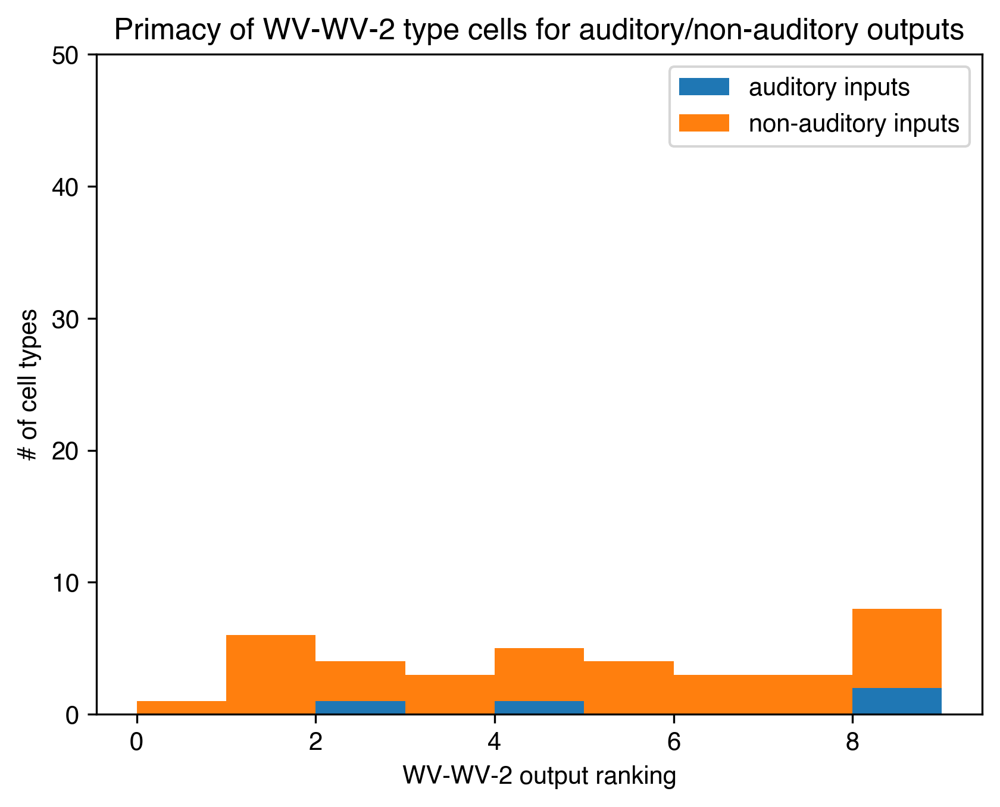

In [66]:
#wv-wv-2

wvwv2_aud_ranks = class_primacy[class_primacy['class_pre']=='auditory']['wvwv2_rank'].dropna()
wvwv2_nonaud_ranks = class_primacy[class_primacy['class_pre']=='non-auditory']['wvwv2_rank'].dropna()

fig, ax = plt.subplots()
plt.hist([wvwv2_aud_ranks, wvwv2_nonaud_ranks], bins=bins, stacked=True)
plt.title('Primacy of WV-WV-2 type cells for auditory/non-auditory outputs')
ax.set_xlabel('WV-WV-2 output ranking')
ax.set_ylabel('# of cell types')
ax.legend(labels=['auditory inputs', 'non-auditory inputs'])
plt.ylim(0, 50)

(0.0, 50.0)

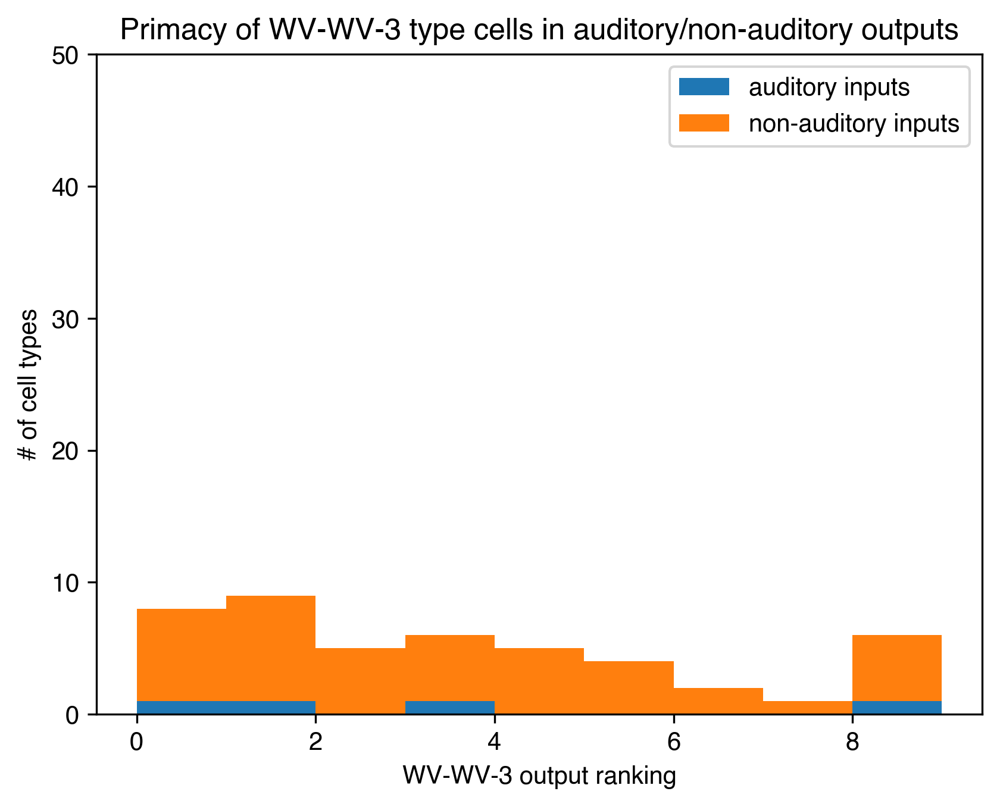

In [67]:
#wv-wv-3

wvwv3_aud_ranks = class_primacy[class_primacy['class_pre']=='auditory']['wvwv3_rank'].dropna()
wvwv3_nonaud_ranks = class_primacy[class_primacy['class_pre']=='non-auditory']['wvwv3_rank'].dropna()

fig, ax = plt.subplots()
plt.hist([wvwv3_aud_ranks, wvwv3_nonaud_ranks], bins=bins, stacked=True)
plt.title('Primacy of WV-WV-3 type cells in auditory/non-auditory outputs')
ax.set_xlabel('WV-WV-3 output ranking')
ax.set_ylabel('# of cell types')
ax.legend(labels=['auditory inputs', 'non-auditory inputs'])
plt.ylim(0, 50)

(0.0, 50.0)

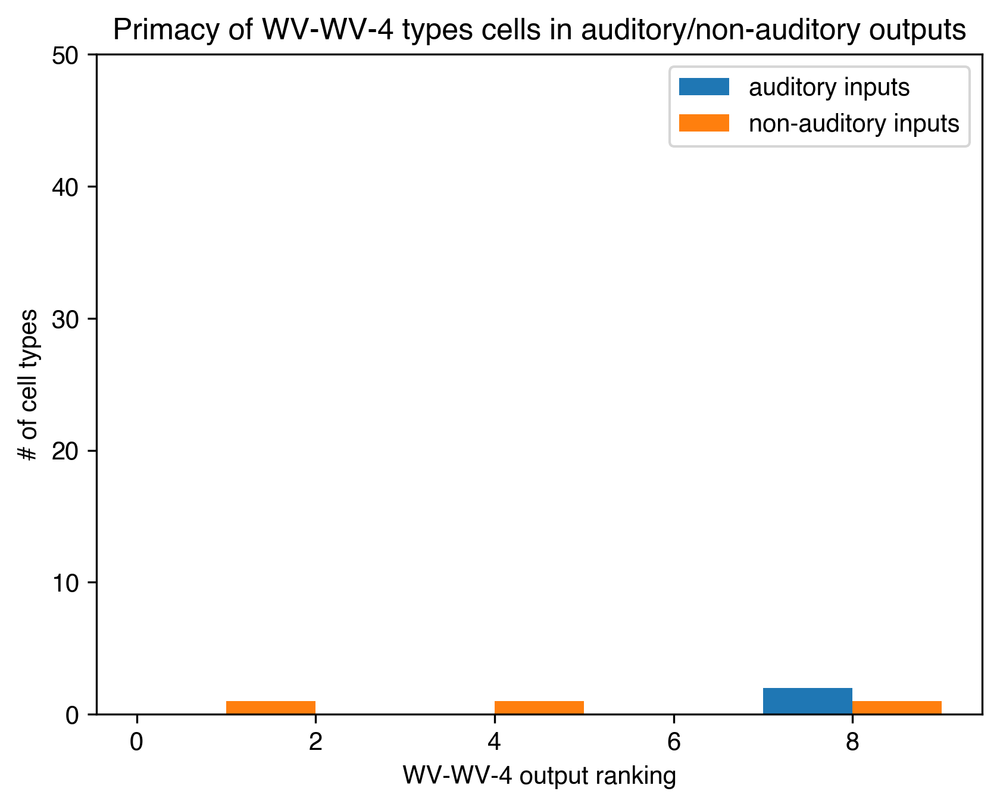

In [68]:
#wv-wv-4

wvwv4_aud_ranks = class_primacy[class_primacy['class_pre']=='auditory']['wvwv4_rank'].dropna()
wvwv4_nonaud_ranks = class_primacy[class_primacy['class_pre']=='non-auditory']['wvwv4_rank'].dropna()

fig, ax = plt.subplots()
plt.hist([wvwv4_aud_ranks, wvwv4_nonaud_ranks], bins=bins, stacked=True)
plt.title('Primacy of WV-WV-4 types cells in auditory/non-auditory outputs')
ax.set_xlabel('WV-WV-4 output ranking')
ax.set_ylabel('# of cell types')
ax.legend(labels=['auditory inputs', 'non-auditory inputs'])
plt.ylim(0, 50)

## Auditory/non-auditory primacy analyses with strong connections only
### Stacked histograms -- distribution of wv-wv output rankings for all inputs of strong connections

(0.0, 16.0)

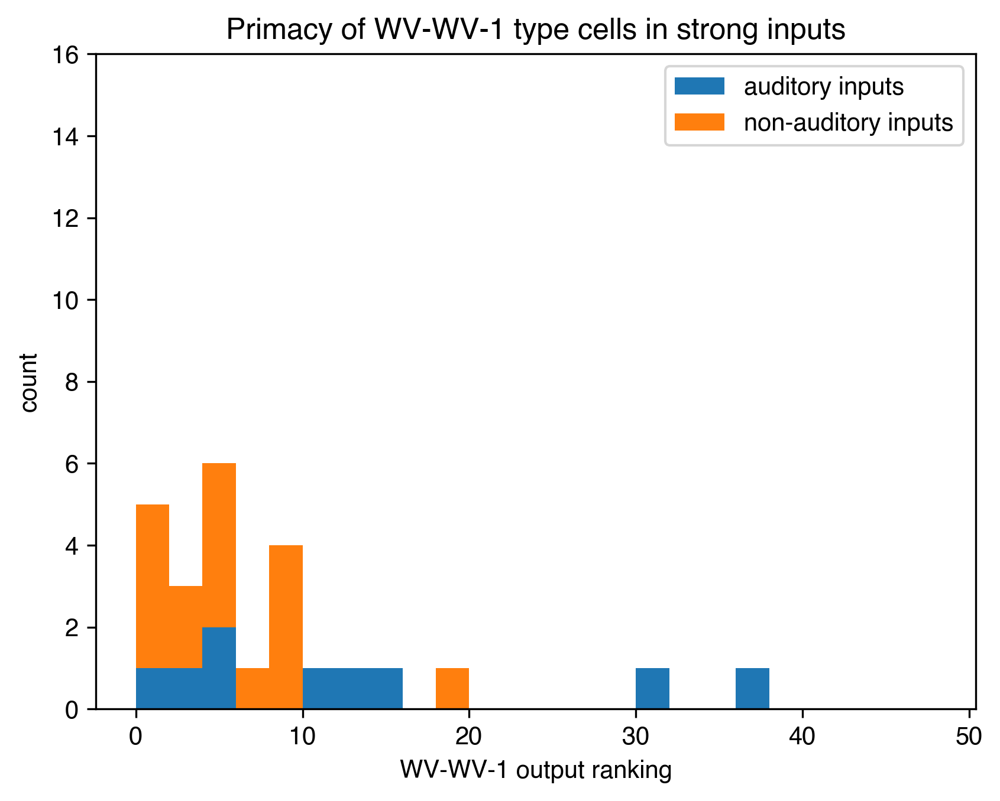

In [69]:
#wv-wv-1

#filter to find only strong inputs
wvwv1_strongconns = class_primacy[class_primacy['wvwv1_syncount']>=wv1_threshold] #filter out weak connections with the threshold we found earlier

#create two separate rank lists for auditory vs non-auditory input cell types
wvwv1_strongaudinput_ranks = wvwv1_strongconns[wvwv1_strongconns['class_pre']=='auditory']['wvwv1_rank']
wvwv1_strongnonaudinput_ranks = wvwv1_strongconns[wvwv1_strongconns['class_pre']=='non-auditory']['wvwv1_rank']

#plot
fig, ax = plt.subplots()
plt.hist([wvwv1_strongaudinput_ranks, wvwv1_strongnonaudinput_ranks], bins=np.arange(0, 50, 2), stacked=True)
plt.title('Primacy of WV-WV-1 type cells in strong inputs')
ax.set_xlabel('WV-WV-1 output ranking')
ax.set_ylabel('count')
ax.legend(labels=['auditory inputs', 'non-auditory inputs'])
plt.ylim(0, 16)


(0.0, 16.0)

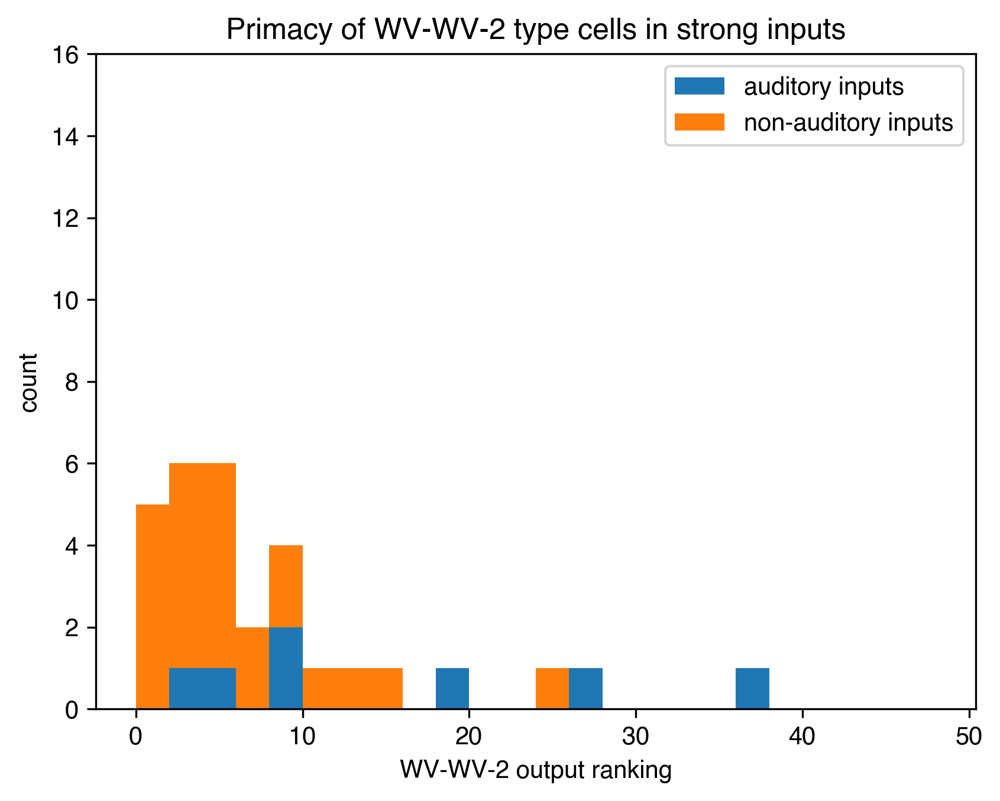

In [70]:
#wv-wv-2

#filter to find only strong inputs
wvwv2_strongconns = class_primacy[class_primacy['wvwv2_syncount']>=wv2_threshold]

#create two separate rank lists for auditory vs non-auditory input cell types
wvwv2_strongaudinput_ranks = wvwv2_strongconns[wvwv2_strongconns['class_pre']=='auditory']['wvwv2_rank']
wvwv2_strongnonaudinput_ranks = wvwv2_strongconns[wvwv2_strongconns['class_pre']=='non-auditory']['wvwv2_rank']

#plot
fig, ax = plt.subplots()
plt.hist([wvwv2_strongaudinput_ranks, wvwv2_strongnonaudinput_ranks], bins=np.arange(0, 50, 2), stacked=True)
plt.title('Primacy of WV-WV-2 type cells in strong inputs')
ax.set_xlabel('WV-WV-2 output ranking')
ax.set_ylabel('count')
ax.legend(labels=['auditory inputs', 'non-auditory inputs'])
plt.ylim(0, 16)


(0.0, 16.0)

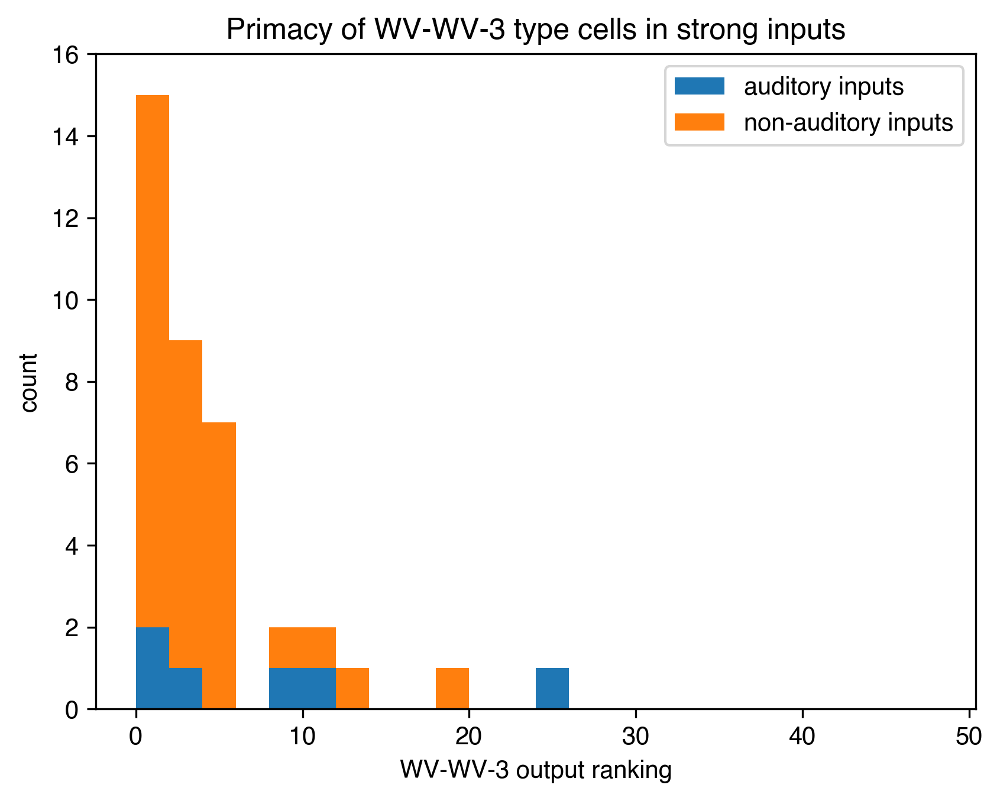

In [71]:
#wv-wv-3

#filter to find only strong inputs
wvwv3_strongconns = class_primacy[class_primacy['wvwv3_syncount']>=wv3_threshold]

#create two separate rank lists for auditory vs non-auditory input cell types
wvwv3_strongaudinput_ranks = wvwv3_strongconns[wvwv3_strongconns['class_pre']=='auditory']['wvwv3_rank']
wvwv3_strongnonaudinput_ranks = wvwv3_strongconns[wvwv3_strongconns['class_pre']=='non-auditory']['wvwv3_rank']

#plot
fig, ax = plt.subplots()
plt.hist([wvwv3_strongaudinput_ranks, wvwv3_strongnonaudinput_ranks], bins=np.arange(0, 50, 2), stacked=True)
plt.title('Primacy of WV-WV-3 type cells in strong inputs')
ax.set_xlabel('WV-WV-3 output ranking')
ax.set_ylabel('count')
ax.legend(labels=['auditory inputs', 'non-auditory inputs'])
plt.ylim(0, 16)


(0.0, 16.0)

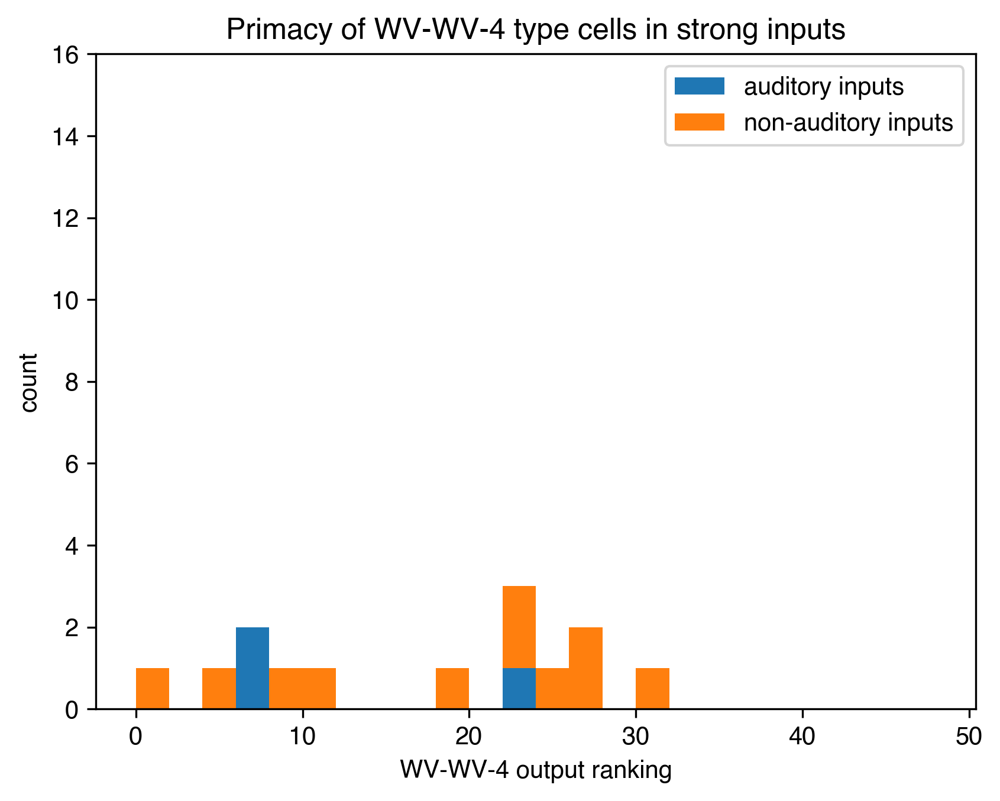

In [72]:
#wv-wv-4

#filter to find only strong inputs
wvwv4_strongconns = class_primacy[class_primacy['wvwv4_syncount']>=wv4_threshold]

#create two separate rank lists for auditory vs non-auditory input cell types
wvwv4_strongaudinput_ranks = wvwv4_strongconns[wvwv4_strongconns['class_pre']=='auditory']['wvwv4_rank']
wvwv4_strongnonaudinput_ranks = wvwv4_strongconns[wvwv4_strongconns['class_pre']=='non-auditory']['wvwv4_rank']

#plot
fig, ax = plt.subplots()
plt.hist([wvwv4_strongaudinput_ranks, wvwv4_strongnonaudinput_ranks], bins=np.arange(0, 50, 2), stacked=True)
plt.title('Primacy of WV-WV-4 type cells in strong inputs')
ax.set_xlabel('WV-WV-4 output ranking')
ax.set_ylabel('count')
ax.legend(labels=['auditory inputs', 'non-auditory inputs'])
plt.ylim(0, 16)


### Stacked bar figures -- # of inputs cells where wv-wv ranks within top 10 outputs for that cell

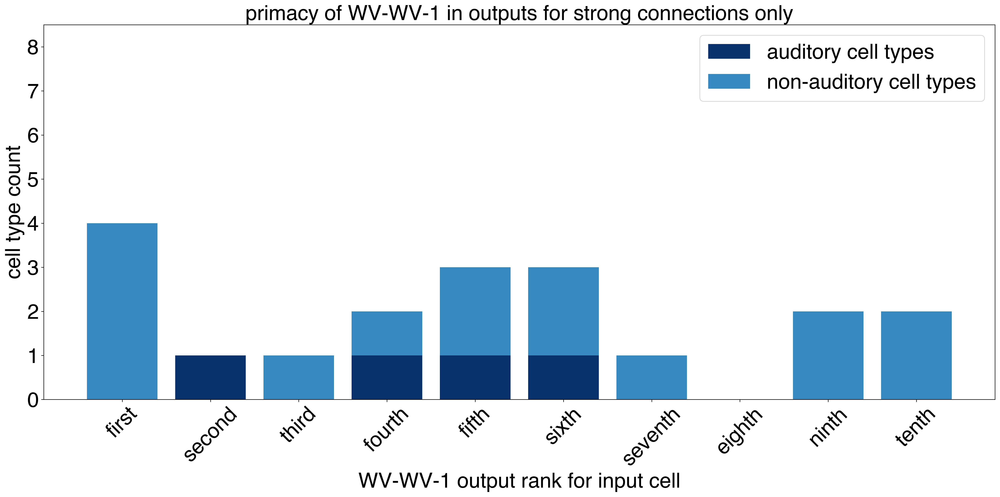

In [73]:
#wv-wv-1

#filter for only strong connections but retain classification info
strong_aud_ranks = class_primacy[(class_primacy['wvwv1_syncount']>=wv1_threshold) & (class_primacy['class_pre']=='auditory')]['wvwv1_rank']
strong_nonaud_ranks = class_primacy[(class_primacy['wvwv1_syncount']>=wv1_threshold) & (class_primacy['class_pre']=='non-auditory')]['wvwv1_rank']

cmap = mpl.colormaps['Blues'].resampled(4).reversed()

strong_counts, strong_bins = np.histogram(strong_aud_ranks, bins=np.arange(-0.5, 10, 1))
weak_counts, weak_bins = np.histogram(strong_nonaud_ranks, bins=np.arange(-0.5, 10, 1))
bins = np.arange(0, 10, 1)

fig, ax = plt.subplots(figsize=(20, 10))
ax.bar(bins, strong_counts, color=cmap([0]))
ax.bar(bins, weak_counts, color=cmap([1]), bottom=strong_counts)
ax.set_ylabel('cell type count', fontsize=30)
ax.set_xlabel('WV-WV-1 output rank for input cell', fontsize=30)
ax.set_xticks(bins)
ax.set_xticklabels(['first', 'second', 'third', 'fourth', 'fifth', 'sixth', 'seventh', 'eighth', 'ninth', 'tenth'],
                   rotation=45, fontsize=30)
ax.legend(['auditory cell types', 'non-auditory cell types'],fontsize=30)
plt.title('primacy of WV-WV-1 in outputs for strong connections only', fontsize=30)
plt.ylim(0, 8.5)
plt.yticks(fontsize=30)

fig.tight_layout()
plt.show()

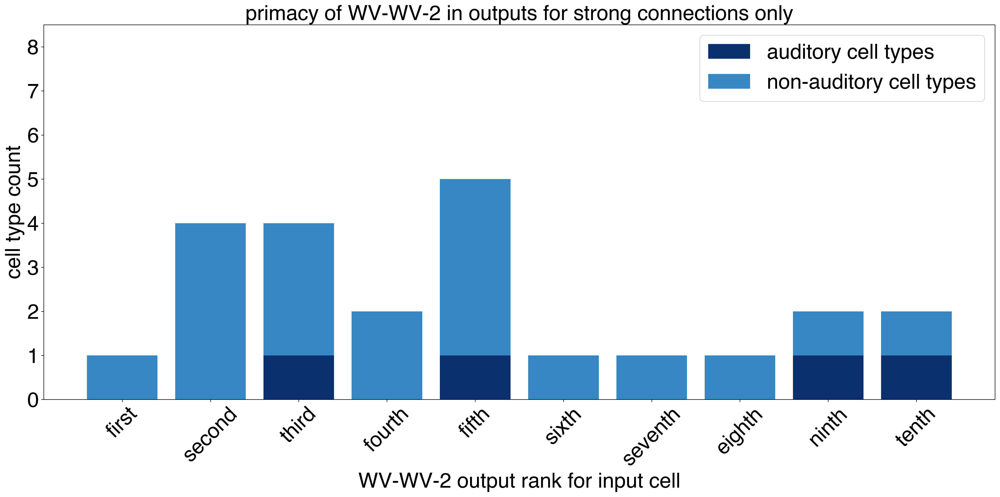

In [74]:
#wv-wv-2

#filter for only strong connections but retain classification info
strong_aud_ranks = class_primacy[(class_primacy['wvwv2_syncount']>=wv2_threshold) & (class_primacy['class_pre']=='auditory')]['wvwv2_rank']
strong_nonaud_ranks = class_primacy[(class_primacy['wvwv2_syncount']>=wv2_threshold) & (class_primacy['class_pre']=='non-auditory')]['wvwv2_rank']

cmap = mpl.colormaps['Blues'].resampled(4).reversed()

strong_counts, strong_bins = np.histogram(strong_aud_ranks, bins=np.arange(-0.5, 10, 1))
weak_counts, weak_bins = np.histogram(strong_nonaud_ranks, bins=np.arange(-0.5, 10, 1))
bins = np.arange(0, 10, 1)

fig, ax = plt.subplots(figsize=(20, 10))
ax.bar(bins, strong_counts, color=cmap([0]))
ax.bar(bins, weak_counts, color=cmap([1]), bottom=strong_counts)
ax.set_ylabel('cell type count', fontsize=30)
ax.set_xlabel('WV-WV-2 output rank for input cell', fontsize=30)
ax.set_xticks(bins)
ax.set_xticklabels(['first', 'second', 'third', 'fourth', 'fifth', 'sixth', 'seventh', 'eighth', 'ninth', 'tenth'],
                   rotation=45, fontsize=30)
ax.legend(['auditory cell types', 'non-auditory cell types'],fontsize=30)
plt.title('primacy of WV-WV-2 in outputs for strong connections only', fontsize=30)
plt.ylim(0, 8.5)
plt.yticks(fontsize=30)

fig.tight_layout()
plt.show()

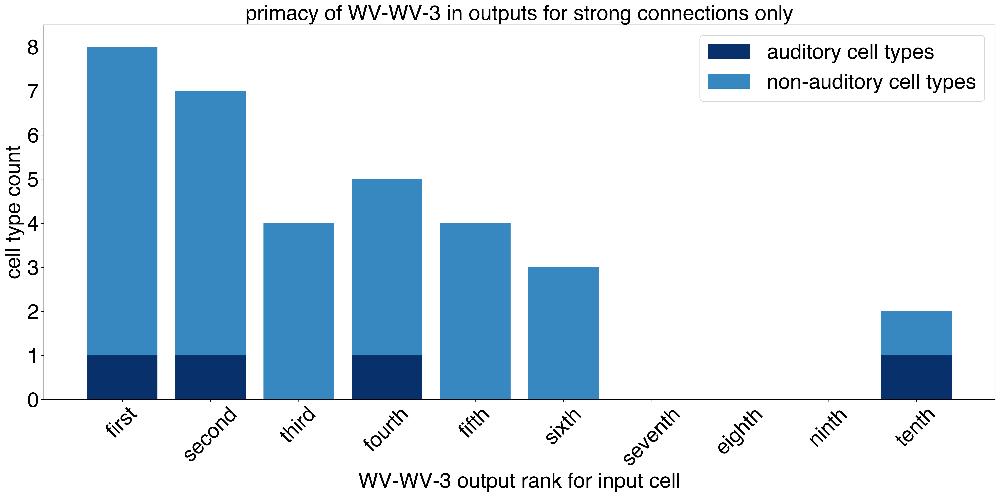

In [75]:
#wv-wv-3

#filter for only strong connections but retain classification info
strong_aud_ranks = class_primacy[(class_primacy['wvwv3_syncount']>=wv3_threshold) & (class_primacy['class_pre']=='auditory')]['wvwv3_rank']
strong_nonaud_ranks = class_primacy[(class_primacy['wvwv3_syncount']>=wv3_threshold) & (class_primacy['class_pre']=='non-auditory')]['wvwv3_rank']

cmap = mpl.colormaps['Blues'].resampled(4).reversed()

strong_counts, strong_bins = np.histogram(strong_aud_ranks, bins=np.arange(-0.5, 10, 1))
weak_counts, weak_bins = np.histogram(strong_nonaud_ranks, bins=np.arange(-0.5, 10, 1))
bins = np.arange(0, 10, 1)

fig, ax = plt.subplots(figsize=(20, 10))
ax.bar(bins, strong_counts, color=cmap([0]))
ax.bar(bins, weak_counts, color=cmap([1]), bottom=strong_counts)
ax.set_ylabel('cell type count', fontsize=30)
ax.set_xlabel('WV-WV-3 output rank for input cell', fontsize=30)
ax.set_xticks(bins)
ax.set_xticklabels(['first', 'second', 'third', 'fourth', 'fifth', 'sixth', 'seventh', 'eighth', 'ninth', 'tenth'],
                   rotation=45, fontsize=30)
ax.legend(['auditory cell types', 'non-auditory cell types'],fontsize=30)
plt.title('primacy of WV-WV-3 in outputs for strong connections only', fontsize=30)
plt.ylim(0, 8.5)
plt.yticks(fontsize=30)

fig.tight_layout()
plt.show()

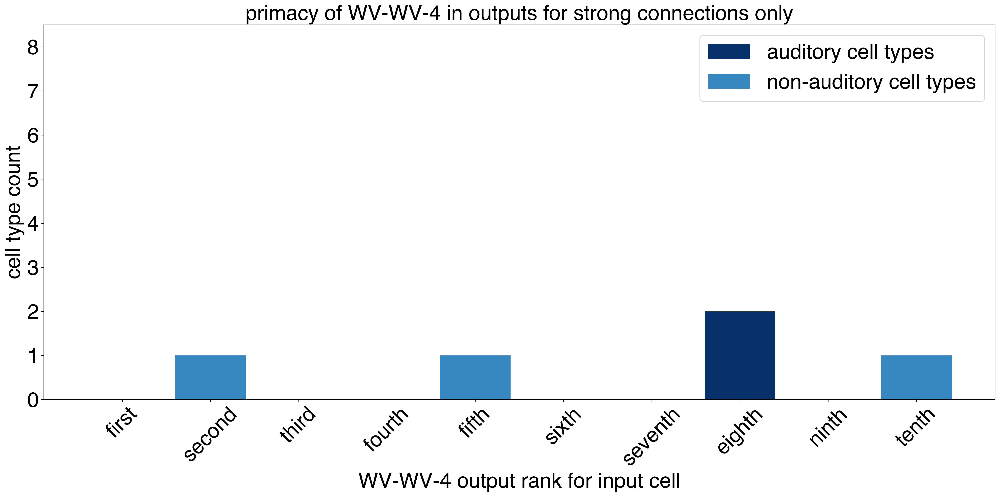

In [76]:
#wv-wv-4

#filter for only strong connections but retain classification info
strong_aud_ranks = class_primacy[(class_primacy['wvwv4_syncount']>=wv4_threshold) & (class_primacy['class_pre']=='auditory')]['wvwv4_rank']
strong_nonaud_ranks = class_primacy[(class_primacy['wvwv4_syncount']>=wv4_threshold) & (class_primacy['class_pre']=='non-auditory')]['wvwv4_rank']

cmap = mpl.colormaps['Blues'].resampled(4).reversed()

strong_counts, strong_bins = np.histogram(strong_aud_ranks, bins=np.arange(-0.5, 10, 1))
weak_counts, weak_bins = np.histogram(strong_nonaud_ranks, bins=np.arange(-0.5, 10, 1))
bins = np.arange(0, 10, 1)

fig, ax = plt.subplots(figsize=(20, 10))
ax.bar(bins, strong_counts, color=cmap([0]))
ax.bar(bins, weak_counts, color=cmap([1]), bottom=strong_counts)
ax.set_ylabel('cell type count', fontsize=30)
ax.set_xlabel('WV-WV-4 output rank for input cell', fontsize=30)
ax.set_xticks(bins)
ax.set_xticklabels(['first', 'second', 'third', 'fourth', 'fifth', 'sixth', 'seventh', 'eighth', 'ninth', 'tenth'],
                   rotation=45, fontsize=30)
ax.legend(['auditory cell types', 'non-auditory cell types'],fontsize=30)
plt.title('primacy of WV-WV-4 in outputs for strong connections only', fontsize=30)
plt.ylim(0, 8.5)
plt.yticks(fontsize=30)

fig.tight_layout()
plt.show()

# Primacy Network Graph
Now that I have a table with all the primary inputs to wv-wvs, I'm going to make a network graph of only primary inputs and see if some kind of structure emerges. I'm going to do this by first finding all the inputs for which one or more of the wv-wvs are primary to, and then I'm going to filter only for connections with those cell types in my connections dataframes.

### With only primary input cell types

In [77]:
#if wvwv is the primary output, the rank will be 0, so filter primacy table for only cell types where at least one wvwv ranks at 0
primary_inputs = primacy[primacy['top_wvwv_rank']==0]['type_pre']
primary_inputs

201      JO-A
128    CB1948
173     DNg40
116    CB1538
170     DNg24
79     CB0261
73     CB0027
117    CB1557
151    CB3105
230    SAD023
172     DNg30
194     DNp55
98     CB1065
Name: type_pre, dtype: object

In [78]:
#graph only those connections

primary_input_conns = wvwv_inputs[wvwv_inputs['type_pre'].isin(primary_inputs)]
primary_input_conns

,pre_root_id,post_root_id,syn_count,nt_type,type_pre,type_post,pref_pre,pref_post,class_pre,class_post
2141,720575940622996579,720575940627201579,252,GLUT,DNg40,WV-WV-3,NaN,NaN,non-auditory,auditory
2741,720575940626901136,720575940627201579,236,GLUT,DNg40,WV-WV-3,NaN,NaN,non-auditory,auditory
4618,720575940624750480,720575940635330204,203,GABA,DNg24,WV-WV-1,NaN,NaN,non-auditory,auditory
5116,720575940639118926,720575940605214636,196,GABA,DNg24,WV-WV-3,NaN,NaN,non-auditory,auditory
6993,720575940624750480,720575940605214636,177,GABA,DNg24,WV-WV-3,NaN,NaN,non-auditory,auditory
...,...,...,...,...,...,...,...,...,...,...
3647845,720575940633483444,720575940632945177,5,GABA,CB1538,WV-WV-3,NaN,NaN,non-auditory,auditory
3652758,720575940624750480,720575940618342966,5,GABA,DNg24,WV-WV-2,NaN,NaN,non-auditory,auditory
3653257,720575940624770540,720575940625345328,5,ACH,JO-A,WV-WV-2,NaN,NaN,auditory,auditory
3715523,720575940623446860,720575940621717469,5,SER,DNg30,WV-WV-3,NaN,NaN,non-auditory,auditory


In [79]:
#also include outputs to those cells, if any

outputs_to_primary = wvwv_outputs[wvwv_outputs['type_post'].isin(primary_inputs)]
outputs_to_primary

,pre_root_id,post_root_id,syn_count,nt_type,type_pre,type_post,pref_pre,pref_post,class_pre,class_post
1300,720575940605214636,720575940624750480,295,GABA,WV-WV-3,DNg24,NaN,NaN,auditory,non-auditory
1512,720575940605214636,720575940639118926,280,GABA,WV-WV-3,DNg24,NaN,NaN,auditory,non-auditory
18815,720575940623322877,720575940602380768,122,GABA,WV-WV-1,CB1538,NaN,NaN,auditory,non-auditory
21591,720575940622123981,720575940631353484,114,GABA,WV-WV-1,CB0261,NaN,NaN,auditory,non-auditory
28846,720575940622123981,720575940624504212,99,GABA,WV-WV-1,CB0261,NaN,NaN,auditory,non-auditory
...,...,...,...,...,...,...,...,...,...,...
3353156,720575940625345328,720575940614026390,5,GABA,WV-WV-2,CB1948,NaN,NaN,auditory,non-auditory
3560554,720575940621717469,720575940633044449,5,GABA,WV-WV-3,CB1557,NaN,NaN,auditory,non-auditory
3560568,720575940621717469,720575940614026390,5,GABA,WV-WV-3,CB1948,NaN,NaN,auditory,non-auditory
3699306,720575940634571383,720575940627646026,5,GABA,WV-WV-2,CB1538,NaN,NaN,auditory,non-auditory


In [80]:
#group both dfs by cell type

primary_input_types = primary_input_conns.groupby(['type_pre', 'type_post', 'pref_pre', 'pref_post', 'class_pre', 'class_post'], as_index=False, dropna=False)[['syn_count']].sum()
outputs_to_primary_types = outputs_to_primary.groupby(['type_pre', 'type_post', 'pref_pre', 'pref_post', 'class_pre', 'class_post'], as_index=False, dropna=False)[['syn_count']].sum()

#concatenate

primary_inputs_network = pd.concat([primary_input_types, outputs_to_primary_types], ignore_index=True)
primary_inputs_network #to save space only display top 10 rows

,type_pre,type_post,pref_pre,pref_post,class_pre,class_post,syn_count
0,CB0027,WV-WV-1,NaN,NaN,non-auditory,auditory,186
1,CB0027,WV-WV-2,NaN,NaN,non-auditory,auditory,113
2,CB0027,WV-WV-3,NaN,NaN,non-auditory,auditory,89
3,CB0261,WV-WV-2,NaN,NaN,non-auditory,auditory,111
4,CB0261,WV-WV-3,NaN,NaN,non-auditory,auditory,683
...,...,...,...,...,...,...,...
69,WV-WV-4,DNg24,NaN,NaN,auditory,non-auditory,6
70,WV-WV-4,DNg40,NaN,NaN,auditory,non-auditory,23
71,WV-WV-4,DNp55,NaN,NaN,auditory,non-auditory,12
72,WV-WV-4,JO-A,NaN,NaN,auditory,auditory,6


In [83]:
#add color coding; first create new columns

primary_inputs_network = primary_inputs_network.rename(columns={'type_pre':'source', 'type_post':'target'})
primary_inputs_network

,source,target,pref_pre,pref_post,class_pre,class_post,syn_count,source_color,target_color
0,CB0027,WV-WV-1,NaN,NaN,non-auditory,auditory,186,grey,mediumpurple
1,CB0027,WV-WV-2,NaN,NaN,non-auditory,auditory,113,grey,mediumpurple
2,CB0027,WV-WV-3,NaN,NaN,non-auditory,auditory,89,grey,mediumpurple
3,CB0261,WV-WV-2,NaN,NaN,non-auditory,auditory,111,grey,mediumpurple
4,CB0261,WV-WV-3,NaN,NaN,non-auditory,auditory,683,grey,mediumpurple
...,...,...,...,...,...,...,...,...,...
69,WV-WV-4,DNg24,NaN,NaN,auditory,non-auditory,6,mediumpurple,grey
70,WV-WV-4,DNg40,NaN,NaN,auditory,non-auditory,23,mediumpurple,grey
71,WV-WV-4,DNp55,NaN,NaN,auditory,non-auditory,12,mediumpurple,grey
72,WV-WV-4,JO-A,NaN,NaN,auditory,auditory,6,mediumpurple,mediumpurple


In [84]:
#fill color column values

class_colordic = {'auditory':'mediumpurple',
                  'non-auditory':'grey'}

primary_inputs_network['source_color'] = primary_inputs_network['class_pre'].map(class_colordic)
primary_inputs_network['target_color'] = primary_inputs_network['class_post'].map(class_colordic)

primary_inputs_network

,source,target,pref_pre,pref_post,class_pre,class_post,syn_count,source_color,target_color
0,CB0027,WV-WV-1,NaN,NaN,non-auditory,auditory,186,grey,mediumpurple
1,CB0027,WV-WV-2,NaN,NaN,non-auditory,auditory,113,grey,mediumpurple
2,CB0027,WV-WV-3,NaN,NaN,non-auditory,auditory,89,grey,mediumpurple
3,CB0261,WV-WV-2,NaN,NaN,non-auditory,auditory,111,grey,mediumpurple
4,CB0261,WV-WV-3,NaN,NaN,non-auditory,auditory,683,grey,mediumpurple
...,...,...,...,...,...,...,...,...,...
69,WV-WV-4,DNg24,NaN,NaN,auditory,non-auditory,6,mediumpurple,grey
70,WV-WV-4,DNg40,NaN,NaN,auditory,non-auditory,23,mediumpurple,grey
71,WV-WV-4,DNp55,NaN,NaN,auditory,non-auditory,12,mediumpurple,grey
72,WV-WV-4,JO-A,NaN,NaN,auditory,auditory,6,mediumpurple,mediumpurple


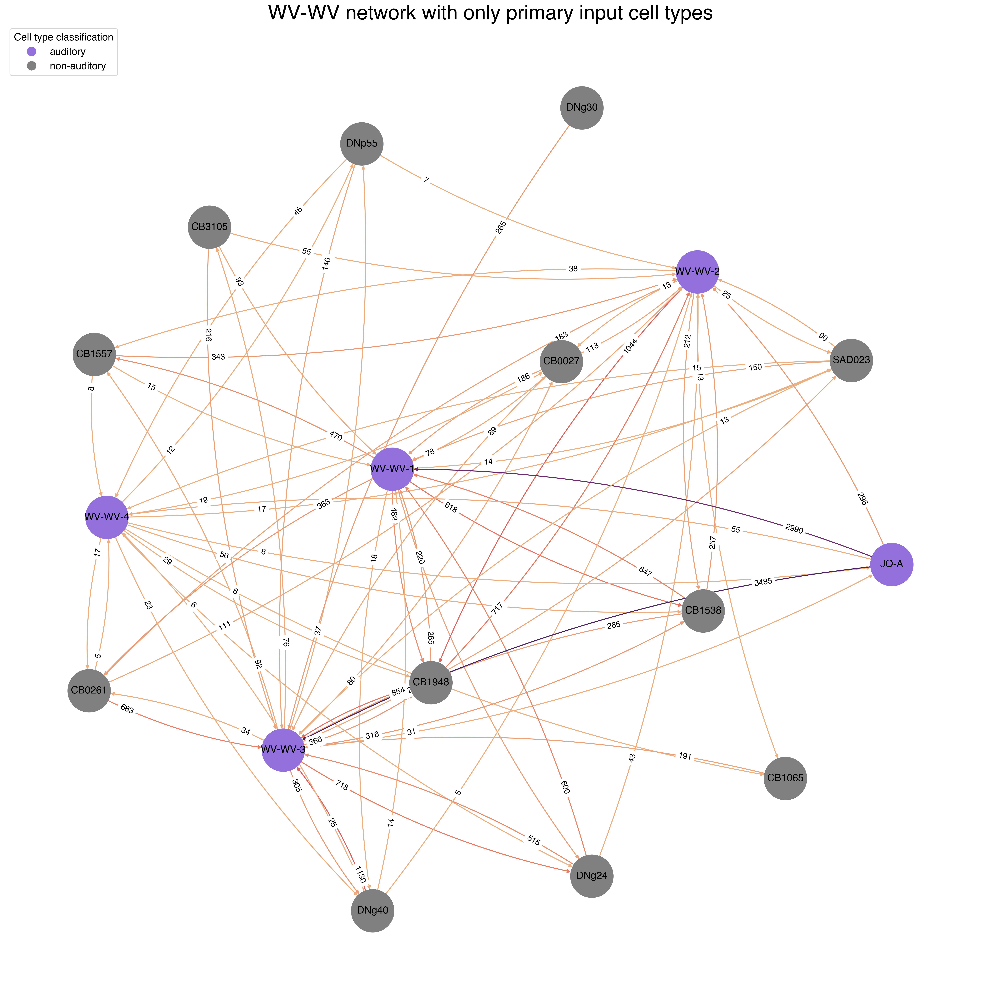

In [85]:
#graph

G_priminputs = nx.MultiDiGraph()

for i, row in primary_inputs_network.iterrows():
    G_priminputs.add_node(row['source'], label=row['source'], color=row['source_color'])
    G_priminputs.add_node(row['target'], label=row['target'], color=row['target_color'])

for i, row in primary_inputs_network.iterrows():
    G_priminputs.add_edge(row['source'], row['target'], weight=row['syn_count'])

plt.figure(figsize=(20, 20))
pos = nx.arf_layout(G_priminputs, seed=3, scaling=5)
nx.draw(G_priminputs, pos, with_labels=True,
        node_color=[data['color'] for node, data in G_priminputs.nodes(data=True)],
        node_size=4000,
        font_size=15,
        edge_cmap=seaborn.color_palette('flare', as_cmap=True),
        edge_color=[data['weight'] for u, v, data in G_priminputs.edges(data=True)],
        width=1.5,
        connectionstyle='arc3,rad=0.1')

nx.draw_networkx_edge_labels(G_priminputs, pos,
                            edge_labels={(u, v): d['weight'] for u, v, d in G_priminputs.edges(data=True)},
                            font_size=12,
                            label_pos=0.2,
                            connectionstyle='arc3,rad=0.1')

plt.title('WV-WV network with only primary input cell types', fontsize=30)
plt.legend(
    handles=[
        plt.Line2D([0], [0], marker='o', color='w', label='auditory', markerfacecolor='mediumpurple', markersize=15),
        plt.Line2D([0], [0], marker='o', color='w', label='non-auditory', markerfacecolor='grey', markersize=15),
    ],
    title="Cell type classification",
    title_fontsize=15,
    loc="upper left",
    fontsize=15
)

### Primary inputs and top outputs
What would a network graph look like if we only included primary inputs but instead of outputs to those same cells, we include outputs to top outputs for each cell?

In [86]:
#keeping the primary inputs df
primary_input_types

,type_pre,type_post,pref_pre,pref_post,class_pre,class_post,syn_count
0,CB0027,WV-WV-1,NaN,NaN,non-auditory,auditory,186
1,CB0027,WV-WV-2,NaN,NaN,non-auditory,auditory,113
2,CB0027,WV-WV-3,NaN,NaN,non-auditory,auditory,89
3,CB0261,WV-WV-2,NaN,NaN,non-auditory,auditory,111
4,CB0261,WV-WV-3,NaN,NaN,non-auditory,auditory,683
5,CB0261,WV-WV-4,NaN,NaN,non-auditory,auditory,5
6,CB1065,WV-WV-3,NaN,NaN,non-auditory,auditory,191
7,CB1538,WV-WV-1,NaN,NaN,non-auditory,auditory,647
8,CB1538,WV-WV-2,NaN,NaN,non-auditory,auditory,257
9,CB1538,WV-WV-3,NaN,NaN,non-auditory,auditory,265


In [96]:
#take the top 5 output cell types for each subtype

wvwv1_t5outputs = wvwv1_outputs.groupby(['type_pre', 'type_post', 'pref_pre', 'pref_post', 'class_pre', 'class_post'], as_index=False, dropna=False)[['syn_count']].sum().sort_values(by='syn_count', ascending=False).head(5)
wvwv2_t5outputs = wvwv2_outputs.groupby(['type_pre', 'type_post', 'pref_pre', 'pref_post', 'class_pre', 'class_post'], as_index=False, dropna=False)[['syn_count']].sum().sort_values(by='syn_count', ascending=False).head(5)
wvwv3_t5outputs = wvwv3_outputs.groupby(['type_pre', 'type_post', 'pref_pre', 'pref_post', 'class_pre', 'class_post'], as_index=False, dropna=False)[['syn_count']].sum().sort_values(by='syn_count', ascending=False).head(5)
wvwv4_t5outputs = wvwv4_outputs.groupby(['type_pre', 'type_post', 'pref_pre', 'pref_post', 'class_pre', 'class_post'], as_index=False, dropna=False)[['syn_count']].sum().sort_values(by='syn_count', ascending=False).head(5)

#concat
wvwv_indiv_t5outputs = pd.concat([wvwv1_t5outputs, wvwv2_t5outputs, wvwv3_t5outputs, wvwv4_t5outputs], ignore_index=True)
wvwv_indiv_t5outputs

,type_pre,type_post,pref_pre,pref_post,class_pre,class_post,syn_count
0,WV-WV-1,WED-VLP,NaN,intermediate,auditory,auditory,3189
1,WV-WV-1,WED_pr02,NaN,intermediate,auditory,auditory,2011
2,WV-WV-1,AVLP_pr01,NaN,sine,auditory,auditory,965
3,WV-WV-1,CB1538,NaN,NaN,auditory,non-auditory,818
4,WV-WV-1,CB1110,NaN,NaN,auditory,non-auditory,523
5,WV-WV-2,WED_pr02,NaN,intermediate,auditory,auditory,2243
6,WV-WV-2,CB1760,NaN,NaN,auditory,non-auditory,1101
7,WV-WV-2,CB1948,NaN,NaN,auditory,non-auditory,1044
8,WV-WV-2,CB2238,NaN,NaN,auditory,non-auditory,891
9,WV-WV-2,CB0533,NaN,NaN,auditory,non-auditory,873


In [97]:
#concatenate with inputs df

priminputs_topoutputs_network = pd.concat([primary_input_types, wvwv_indiv_t5outputs], ignore_index=True).rename(columns={'type_pre':'source', 'type_post':'target'})
priminputs_topoutputs_network

,source,target,pref_pre,pref_post,class_pre,class_post,syn_count
0,CB0027,WV-WV-1,NaN,NaN,non-auditory,auditory,186
1,CB0027,WV-WV-2,NaN,NaN,non-auditory,auditory,113
2,CB0027,WV-WV-3,NaN,NaN,non-auditory,auditory,89
3,CB0261,WV-WV-2,NaN,NaN,non-auditory,auditory,111
4,CB0261,WV-WV-3,NaN,NaN,non-auditory,auditory,683
5,CB0261,WV-WV-4,NaN,NaN,non-auditory,auditory,5
6,CB1065,WV-WV-3,NaN,NaN,non-auditory,auditory,191
7,CB1538,WV-WV-1,NaN,NaN,non-auditory,auditory,647
8,CB1538,WV-WV-2,NaN,NaN,non-auditory,auditory,257
9,CB1538,WV-WV-3,NaN,NaN,non-auditory,auditory,265


In [98]:
#add same color coding as before

priminputs_topoutputs_network['source_color'] = priminputs_topoutputs_network['class_pre'].map(class_colordic)
priminputs_topoutputs_network['target_color'] = priminputs_topoutputs_network['class_post'].map(class_colordic)

#add color coding if there are preferences
priminputs_topoutputs_network.loc[priminputs_topoutputs_network['pref_pre']=='pulse', 'source_color'] = 'skyblue'
priminputs_topoutputs_network.loc[priminputs_topoutputs_network['pref_post']=='pulse', 'target_color'] = 'skyblue'
priminputs_topoutputs_network.loc[priminputs_topoutputs_network['pref_pre']=='intermediate', 'source_color'] = 'limegreen'
priminputs_topoutputs_network.loc[priminputs_topoutputs_network['pref_post']=='intermediate', 'target_color'] = 'limegreen'
priminputs_topoutputs_network.loc[priminputs_topoutputs_network['pref_pre']=='sine', 'source_color'] = 'gold'
priminputs_topoutputs_network.loc[priminputs_topoutputs_network['pref_post']=='sine', 'target_color'] = 'gold'

#make all wvwvs violet so they stand out
priminputs_topoutputs_network.loc[priminputs_topoutputs_network['source'].str.contains('WV-WV'), 'source_color'] = 'violet'
priminputs_topoutputs_network.loc[priminputs_topoutputs_network['target'].str.contains('WV-WV'), 'target_color'] = 'violet'

priminputs_topoutputs_network

,source,target,pref_pre,pref_post,class_pre,class_post,syn_count,source_color,target_color
0,CB0027,WV-WV-1,NaN,NaN,non-auditory,auditory,186,grey,violet
1,CB0027,WV-WV-2,NaN,NaN,non-auditory,auditory,113,grey,violet
2,CB0027,WV-WV-3,NaN,NaN,non-auditory,auditory,89,grey,violet
3,CB0261,WV-WV-2,NaN,NaN,non-auditory,auditory,111,grey,violet
4,CB0261,WV-WV-3,NaN,NaN,non-auditory,auditory,683,grey,violet
5,CB0261,WV-WV-4,NaN,NaN,non-auditory,auditory,5,grey,violet
6,CB1065,WV-WV-3,NaN,NaN,non-auditory,auditory,191,grey,violet
7,CB1538,WV-WV-1,NaN,NaN,non-auditory,auditory,647,grey,violet
8,CB1538,WV-WV-2,NaN,NaN,non-auditory,auditory,257,grey,violet
9,CB1538,WV-WV-3,NaN,NaN,non-auditory,auditory,265,grey,violet


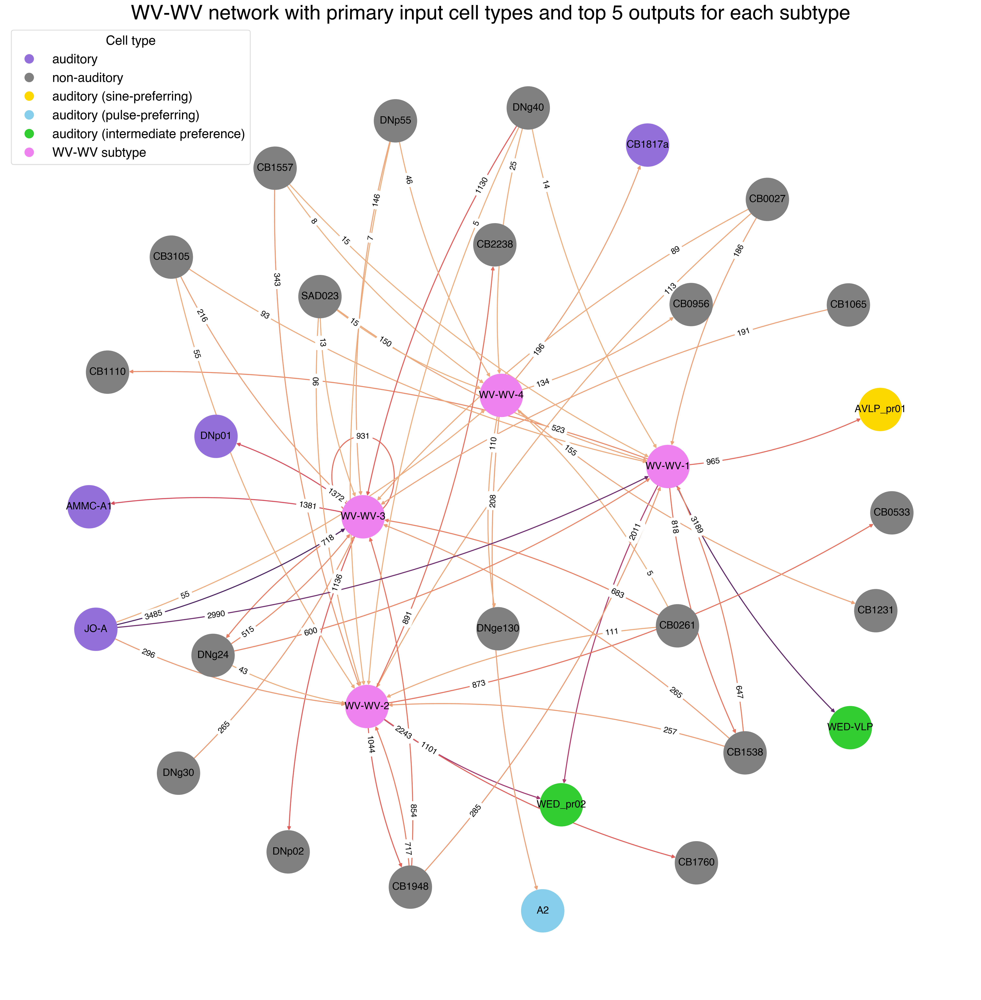

In [99]:
#graph

G_pt = nx.MultiDiGraph()

for i, row in priminputs_topoutputs_network.iterrows():
    G_pt.add_node(row['source'], label=row['source'], color=row['source_color'])
    G_pt.add_node(row['target'], label=row['target'], color=row['target_color'])

for i, row in priminputs_topoutputs_network.iterrows():
    G_pt.add_edge(row['source'], row['target'], weight=row['syn_count'])

plt.figure(figsize=(20, 20))
pos = nx.arf_layout(G_pt, seed=8, scaling=3)
nx.draw(G_pt, pos, with_labels=True,
        node_color=[data['color'] for node, data in G_pt.nodes(data=True)],
        node_size=4000,
        font_size=15,
        edge_cmap=seaborn.color_palette('flare', as_cmap=True),
        edge_color=[data['weight'] for u, v, data in G_pt.edges(data=True)],
        width=1.5,
        connectionstyle='arc3,rad=0.1')

nx.draw_networkx_edge_labels(G_pt, pos,
                            edge_labels={(u, v): d['weight'] for u, v, d in G_pt.edges(data=True)},
                            font_size=12,
                            label_pos=0.2,
                            connectionstyle='arc3,rad=0.1')

plt.title('WV-WV network with primary input cell types and top 5 outputs for each subtype', fontsize=30)
plt.legend(
    handles=[
        plt.Line2D([0], [0], marker='o', color='w', label='auditory', markerfacecolor='mediumpurple', markersize=15),
        plt.Line2D([0], [0], marker='o', color='w', label='non-auditory', markerfacecolor='grey', markersize=15),
        plt.Line2D([0], [0], marker='o', color='w', label='auditory (sine-preferring)', markerfacecolor='gold', markersize=15),
        plt.Line2D([0], [0], marker='o', color='w', label='auditory (pulse-preferring)', markerfacecolor='skyblue', markersize=15),
        plt.Line2D([0], [0], marker='o', color='w', label='auditory (intermediate preference)', markerfacecolor='limegreen', markersize=15),
        plt.Line2D([0], [0], marker='o', color='w', label='WV-WV subtype', markerfacecolor='violet', markersize=15)
    ],
    title="Cell type",
    title_fontsize=19,
    loc="upper left",
    fontsize=19
)

### Primary inputs and top outputs plus their (potential) connections with each other
Now that I have a network graph of primary inputs as well as their top outputs, I want to include edges that connect these inputs and outputs together, if they have one

In [100]:
#search for connections between primary_input_types and wvwv_indiv_t5outputs

#connections with inputs as presynaptic and outputs as postsynaptic
inputs_to_outputs = conns_types[(conns_types['type_pre'].isin(primary_input_types['type_pre'])) & (conns_types['type_post'].isin(wvwv_indiv_t5outputs['type_post']))].groupby(['type_pre', 'type_post', 'pref_pre', 'pref_post', 'class_pre', 'class_post'], as_index=False, dropna=False)[['syn_count']].sum()
inputs_to_outputs.head(10)

,type_pre,type_post,pref_pre,pref_post,class_pre,class_post,syn_count
0,CB0027,AMMC-A1,NaN,NaN,non-auditory,auditory,30
1,CB0027,DNp01,NaN,NaN,non-auditory,auditory,18
2,CB0027,WED-VLP,NaN,intermediate,non-auditory,auditory,9
3,CB0027,WV-WV-3,NaN,NaN,non-auditory,auditory,89
4,CB0261,WV-WV-3,NaN,NaN,non-auditory,auditory,683
5,CB1065,WV-WV-3,NaN,NaN,non-auditory,auditory,191
6,CB1538,AMMC-A1,NaN,NaN,non-auditory,auditory,298
7,CB1538,CB0533,NaN,NaN,non-auditory,non-auditory,32
8,CB1538,CB0956,NaN,NaN,non-auditory,non-auditory,223
9,CB1538,CB1110,NaN,NaN,non-auditory,non-auditory,40


In [101]:
#connections in the opposite direction as above
outputs_to_inputs = conns_types[(conns_types['type_pre'].isin(wvwv_indiv_t5outputs['type_post'])) & (conns_types['type_post'].isin(primary_input_types['type_pre']))].groupby(['type_pre', 'type_post', 'pref_pre', 'pref_post', 'class_pre', 'class_post'], as_index=False, dropna=False)[['syn_count']].sum()
outputs_to_inputs.head(10)

,type_pre,type_post,pref_pre,pref_post,class_pre,class_post,syn_count
0,A2,CB1557,pulse,NaN,auditory,non-auditory,5
1,A2,DNp55,pulse,NaN,auditory,non-auditory,66
2,AMMC-A1,DNg40,NaN,NaN,auditory,non-auditory,43
3,AMMC-A1,SAD023,NaN,NaN,auditory,non-auditory,7
4,AVLP_pr01,CB1557,sine,NaN,auditory,non-auditory,7
5,AVLP_pr01,DNp55,sine,NaN,auditory,non-auditory,11
6,AVLP_pr01,JO-A,sine,NaN,auditory,auditory,10
7,CB0533,CB1557,NaN,NaN,non-auditory,non-auditory,97
8,CB0956,CB0261,NaN,NaN,non-auditory,non-auditory,5
9,CB0956,CB1557,NaN,NaN,non-auditory,non-auditory,72


In [102]:
#concatenate and add to network df used for graph above

non_wvwv_conns = pd.concat([inputs_to_outputs, outputs_to_inputs])

#change column names and add colormap before concatenating with main df

non_wvwv_conns = non_wvwv_conns.rename(columns={'type_pre':'source', 'type_post':'target'})

non_wvwv_conns['source_color'] = non_wvwv_conns['class_pre'].map(class_colordic)
non_wvwv_conns['target_color'] = non_wvwv_conns['class_post'].map(class_colordic)

#add specific coloring for song mode preference cell types and wvwvs

non_wvwv_conns.loc[non_wvwv_conns['pref_pre']=='pulse', 'source_color'] = 'skyblue'
non_wvwv_conns.loc[non_wvwv_conns['pref_post']=='pulse', 'target_color'] = 'skyblue'
non_wvwv_conns.loc[non_wvwv_conns['pref_pre']=='sine', 'source_color'] = 'gold'
non_wvwv_conns.loc[non_wvwv_conns['pref_post']=='sine', 'target_color'] = 'gold'
non_wvwv_conns.loc[non_wvwv_conns['pref_pre']=='intermediate', 'source_color'] = 'limegreen'
non_wvwv_conns.loc[non_wvwv_conns['pref_post']=='intermediate', 'target_color'] = 'limegreen'

#change wvwvs last
non_wvwv_conns.loc[non_wvwv_conns['source'].isin(wvwv), 'source_color'] = 'violet'
non_wvwv_conns.loc[non_wvwv_conns['target'].isin(wvwv), 'target_color'] = 'violet'

non_wvwv_conns

,source,target,pref_pre,pref_post,class_pre,class_post,syn_count,source_color,target_color
0,CB0027,AMMC-A1,NaN,NaN,non-auditory,auditory,30,grey,mediumpurple
1,CB0027,DNp01,NaN,NaN,non-auditory,auditory,18,grey,mediumpurple
2,CB0027,WED-VLP,NaN,intermediate,non-auditory,auditory,9,grey,limegreen
3,CB0027,WV-WV-3,NaN,NaN,non-auditory,auditory,89,grey,mediumpurple
4,CB0261,WV-WV-3,NaN,NaN,non-auditory,auditory,683,grey,mediumpurple
...,...,...,...,...,...,...,...,...,...
51,WV-WV-3,DNg24,NaN,NaN,auditory,non-auditory,718,mediumpurple,grey
52,WV-WV-3,DNg40,NaN,NaN,auditory,non-auditory,305,mediumpurple,grey
53,WV-WV-3,DNp55,NaN,NaN,auditory,non-auditory,37,mediumpurple,grey
54,WV-WV-3,JO-A,NaN,NaN,auditory,auditory,31,mediumpurple,mediumpurple


In [103]:
#concat with primary inputs to top outputs network df
pt2_network = pd.concat([priminputs_topoutputs_network, non_wvwv_conns])

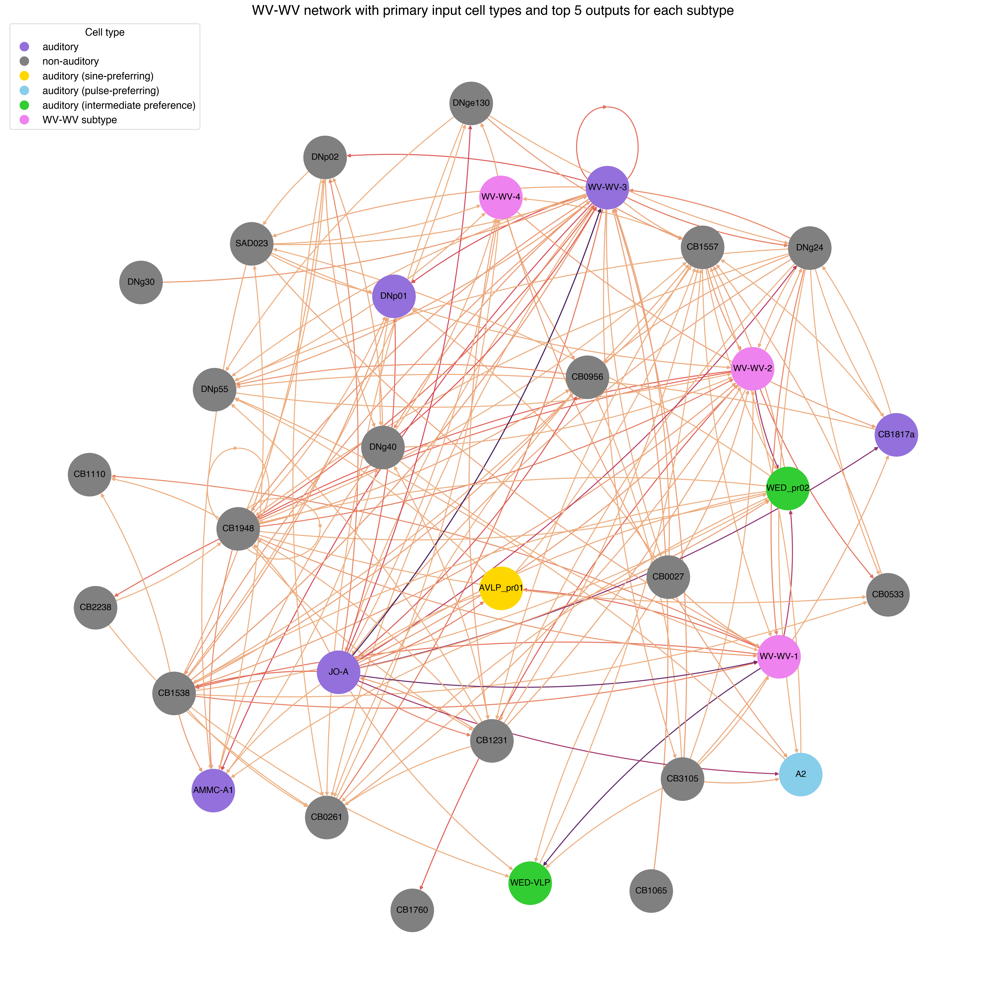

In [104]:
#graph

G_pt2 = nx.MultiDiGraph()

for i, row in pt2_network.iterrows():
    G_pt2.add_node(row['source'], label=row['source'], color=row['source_color'])
    G_pt2.add_node(row['target'], label=row['target'], color=row['target_color'])

for i, row in pt2_network.iterrows():
    G_pt2.add_edge(row['source'], row['target'], weight=row['syn_count'])

plt.figure(figsize=(20, 20))
pos = nx.arf_layout(G_pt2, seed=18, scaling=3)
nx.draw(G_pt2, pos, with_labels=True,
        node_color=[data['color'] for node, data in G_pt2.nodes(data=True)],
        node_size=4000,
        font_size=13,
        width=1.5,
        edge_cmap=seaborn.color_palette('flare', as_cmap=True),
        edge_color=[data['weight'] for u, v, data in G_pt2.edges(data=True)],
        connectionstyle='arc3,rad=0.1')

plt.title('WV-WV network with primary input cell types and top 5 outputs for each subtype', fontsize=20)
plt.legend(
    handles=[
        plt.Line2D([0], [0], marker='o', color='w', label='auditory', markerfacecolor='mediumpurple', markersize=15),
        plt.Line2D([0], [0], marker='o', color='w', label='non-auditory', markerfacecolor='grey', markersize=15),
        plt.Line2D([0], [0], marker='o', color='w', label='auditory (sine-preferring)', markerfacecolor='gold', markersize=15),
        plt.Line2D([0], [0], marker='o', color='w', label='auditory (pulse-preferring)', markerfacecolor='skyblue', markersize=15),
        plt.Line2D([0], [0], marker='o', color='w', label='auditory (intermediate preference)', markerfacecolor='limegreen', markersize=15),
        plt.Line2D([0], [0], marker='o', color='w', label='WV-WV subtype', markerfacecolor='violet', markersize=15),
    ],
    title="Cell type",
    title_fontsize=15,
    loc="upper left",
    fontsize=15
)

In [105]:
#if i added labels to the graph above, it would get crazy so i'm going to filter out weaker connections in the df i'm using so it looks cleaner

pt2_network_above100 = pt2_network[pt2_network['syn_count']>=100]
pt2_network_above100

,source,target,pref_pre,pref_post,class_pre,class_post,syn_count,source_color,target_color
0,CB0027,WV-WV-1,NaN,NaN,non-auditory,auditory,186,grey,violet
1,CB0027,WV-WV-2,NaN,NaN,non-auditory,auditory,113,grey,violet
3,CB0261,WV-WV-2,NaN,NaN,non-auditory,auditory,111,grey,violet
4,CB0261,WV-WV-3,NaN,NaN,non-auditory,auditory,683,grey,violet
6,CB1065,WV-WV-3,NaN,NaN,non-auditory,auditory,191,grey,violet
...,...,...,...,...,...,...,...,...,...
47,WV-WV-3,CB1538,NaN,NaN,auditory,non-auditory,316,mediumpurple,grey
49,WV-WV-3,CB1948,NaN,NaN,auditory,non-auditory,366,mediumpurple,grey
51,WV-WV-3,DNg24,NaN,NaN,auditory,non-auditory,718,mediumpurple,grey
52,WV-WV-3,DNg40,NaN,NaN,auditory,non-auditory,305,mediumpurple,grey


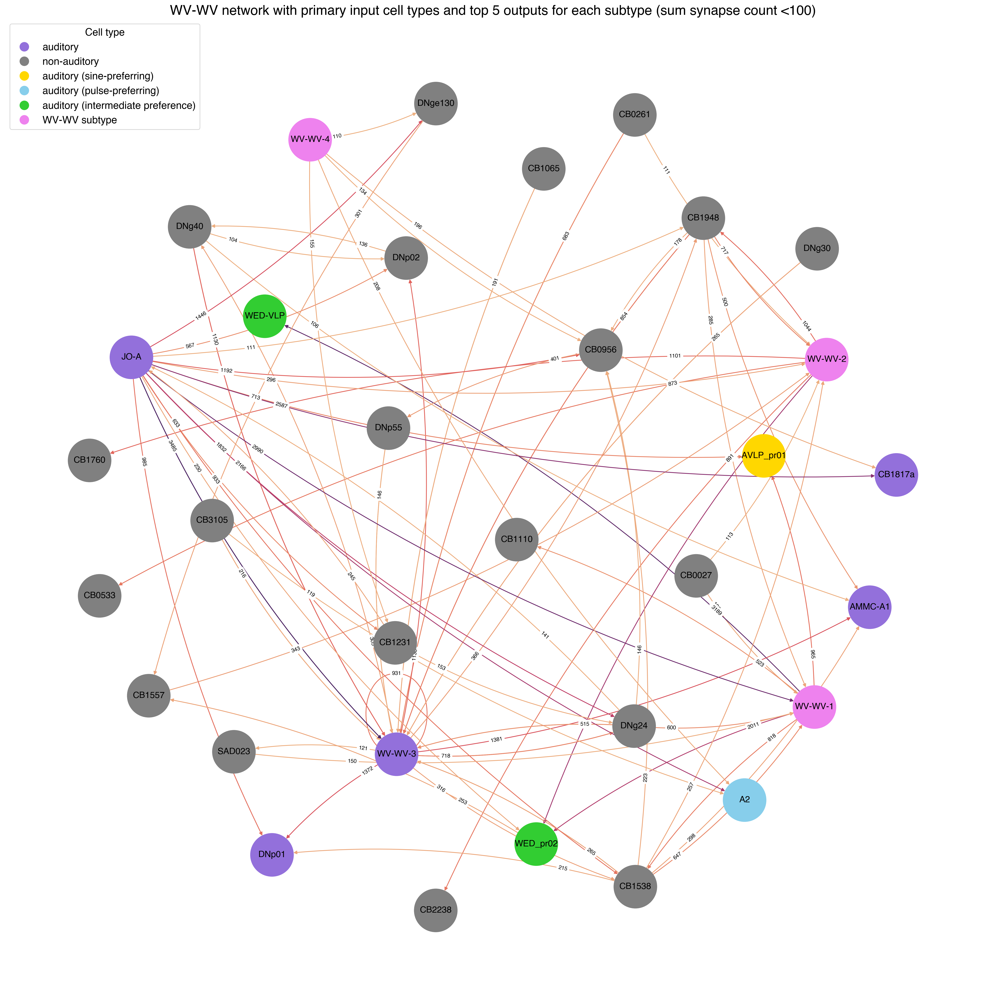

In [106]:
#graph

G_pt3 = nx.MultiDiGraph()

for i, row in pt2_network_above100.iterrows():
    G_pt3.add_node(row['source'], label=row['source'], color=row['source_color'])
    G_pt3.add_node(row['target'], label=row['target'], color=row['target_color'])

for i, row in pt2_network_above100.iterrows():
    G_pt3.add_edge(row['source'], row['target'], weight=row['syn_count'])

plt.figure(figsize=(20, 20))
pos = nx.arf_layout(G_pt3, seed=18, scaling=3)
nx.draw(G_pt3, pos, with_labels=True,
        node_color=[data['color'] for node, data in G_pt3.nodes(data=True)],
        node_size=4000,
        font_size=13,
        edge_cmap=seaborn.color_palette('flare', as_cmap=True),
        edge_color=[data['weight'] for u, v, data in G_pt3.edges(data=True)],
        width=1.2,
        connectionstyle='arc3,rad=0.1')

nx.draw_networkx_edge_labels(G_pt3, pos,
                    edge_labels={(u, v,): d['weight'] for u, v, d in G_pt3.edges(data=True)},
                    font_size=8,
                    label_pos=0.2,
                    connectionstyle='arc3,rad=0.1')

plt.title('WV-WV network with primary input cell types and top 5 outputs for each subtype (sum synapse count <100)', fontsize=20)
plt.legend(
    handles=[
        plt.Line2D([0], [0], marker='o', color='w', label='auditory', markerfacecolor='mediumpurple', markersize=15),
        plt.Line2D([0], [0], marker='o', color='w', label='non-auditory', markerfacecolor='grey', markersize=15),
        plt.Line2D([0], [0], marker='o', color='w', label='auditory (sine-preferring)', markerfacecolor='gold', markersize=15),
        plt.Line2D([0], [0], marker='o', color='w', label='auditory (pulse-preferring)', markerfacecolor='skyblue', markersize=15),
        plt.Line2D([0], [0], marker='o', color='w', label='auditory (intermediate preference)', markerfacecolor='limegreen', markersize=15),
        plt.Line2D([0], [0], marker='o', color='w', label='WV-WV subtype', markerfacecolor='violet', markersize=15)
    ],
    title="Cell type",
    title_fontsize=15,
    loc="upper left",
    fontsize=15
)